In [1]:
%run nb-env.ipynb

[2022-05-10T22:24:35.003600+08:00] Enviroment loaded. Working Dir: /Users/tzhu/work/lab/neo_world/notebooks
Today is 2022-05-10, Working from 2021-04-19 to 2022-05-10


In [2]:
%%time

ori_start_date='2018-02-01' # before drop na
start_date='2018-08-02'
end_date='2021-04-22'

dc, df_init = init_data(start_date, end_date, expire_days=300)
# load cache, with ma_close_* NA data..

Initializing data from 2018-08-02 to 2021-04-22...
Found cache file: ../tmp/price_2018-08-02_2021-04-22_2023-02-26.feather, loading...
CPU times: user 6.03 s, sys: 10.1 s, total: 16.1 s
Wall time: 22.8 s


In [3]:
df = df_init.copy(deep=True)
df

open   high    low  close  pre_close  change  pct_chg  \
ts_code   trade_date                                                           
000001.SZ 2018-08-02   8.88   8.90   8.64   8.70       8.90   -0.21  -2.2951   
          2018-08-03   8.69   8.85   8.67   8.67       8.70   -0.03  -0.3356   
          2018-08-06   8.70   8.86   8.65   8.70       8.67    0.03   0.3367   
          2018-08-07   8.72   8.92   8.64   8.92       8.70    0.23   2.5727   
          2018-08-08   8.91   8.91   8.79   8.80       8.92   -0.12  -1.3086   
...                     ...    ...    ...    ...        ...     ...      ...   
689009.SH 2021-04-16  66.11  70.70  66.11  69.14      64.24    4.90   7.6276   
          2021-04-19  68.90  73.38  68.01  71.24      69.14    2.10   3.0373   
          2021-04-20  70.64  71.89  68.51  69.25      71.24   -1.99  -2.7934   
          2021-04-21  70.96  73.49  69.27  71.51      69.25    2.26   3.2635   
          2021-04-22  70.95  70.95  68.36  69.66      71.51   -1.85  -2.5871   

                            vol     amount  adj_factor  turnover_rate  \
ts_code   trade_date                                                    
000001.SZ 2018-08-02  931401.25  839272.25     108.031         0.5425   
          2018-08-03  476546.62  428641.53     108.031         0.2775   
          2018-08-06  554010.06  497906.70     108.031         0.3227   
          2018-08-07  690423.20  624359.60     108.031         0.4021   
          2018-08-08  578953.20  527527.00     108.031         0.3372   
...                         ...        ...         ...            ...   
689009.SH 2021-04-16   21325.29  146504.39       1.000         3.6982   
          2021-04-19   21113.45  150281.45       1.000         3.6615   
          2021-04-20   15020.11  104490.43       1.000         2.6048   
          2021-04-21   19957.54  143849.67       1.000         3.4610   
          2021-04-22   21781.90  151132.40       1.000         3.7774   

                      turnover_rate_f  volume_ratio        pe    pe_ttm  \
ts_code   trade_date                                                      
000001.SZ 2018-08-02           1.2239          1.30    6.6197    6.5127   
          2018-08-03           0.6262          0.65    6.5975    6.4908   
          2018-08-06           0.7280          0.76    6.6197    6.5127   
          2018-08-07           0.9072          0.99    6.7900    6.6802   
          2018-08-08           0.7608          0.84    6.7011    6.5928   
...                               ...           ...       ...       ...   
689009.SH 2021-04-16           3.6982          1.56  662.5674  662.5674   
          2021-04-19           3.6615          1.56  682.6916  682.6916   
          2021-04-20           2.6048          1.07  663.6215  663.6215   
          2021-04-21           3.4610          1.31  685.2790  685.2790   
          2021-04-22           3.7774          1.23  667.5505  667.5505   

                        total_mv      circ_mv   total_share   float_share  \
ts_code   trade_date                                                        
000001.SZ 2018-08-02  15350348.0  15350201.00  1.717041e+06  1.717025e+06   
          2018-08-03  15298837.0  15298690.00  1.717041e+06  1.717025e+06   
          2018-08-06  15350348.0  15350201.00  1.717041e+06  1.717025e+06   
          2018-08-07  15745267.0  15745116.00  1.717041e+06  1.717025e+06   
          2018-08-08  15539222.0  15539073.00  1.717041e+06  1.717025e+06   
...                          ...          ...           ...           ...   
689009.SH 2021-04-16   4868090.0    398689.84  7.040917e+03  5.766414e+03   
          2021-04-19   5015949.0    410799.30  7.040917e+03  5.766414e+03   
          2021-04-20   4875835.0    399324.16  7.040917e+03  5.766414e+03   
          2021-04-21   5034959.5    412356.25  7.040917e+03  5.766414e+03   
          2021-04-22   4904702.5    401688.38  7.040917e+03  5.766414e+03   

                      free_share  last_factor  norm_ad

### 策略测试区

In [9]:
cols = ['name', 'close', 'conseq_up_num', 'circ_mv', 'total_mv', 'turnover_rate_f', 'vol_ratio', 'amount', 'open_pct', 
        'pct_chg', 'up_type', 'first_time', 'last_time', 'strth', 'next_auc_amt', 'next_open_pct', 'next_pct_chg', 'next2_pct_chg']

last_date = tdu.past_trade_days(end_date=end_date, days=2)[-2]
last_date

'2021-04-21'

#### Just single strategies

In [10]:
s=Strategy(name='1')
s.add_condition('conseq_up_num', '>=', val=1)
# s.add_condition('first_time', '<=', val='09:31:00')

In [14]:
tmp, a = s.get_result(df=df)
tmp = tmp.dropna(subset=['first_time'])
tmp.loc[:,'uptime_rank']= tmp.groupby(['trade_date'])['first_time'].rank(ascending=True).apply(lambda x: int(x))
display_up_df(tmp[cols+['uptime_rank']])

In [6]:
# s.add_condition('first_time', '<=', val='09:31:00')
# rank
tmp.loc[:,'rank'] = df.groupby(['trade_date','ts_code'])['net_buy'].rank(ascending=False, method='max')
print(len(tmp))
print(tmp.next_open_pct.mean())
print(tmp.next_pct_chg.mean())
print(tmp.next2_pct_chg.mean())
display(tmp.tail(3))

9499
5.3749205505014706
4.5122691932420915
6.776211853400507


,,open,high,low,close,pre_close,change,pct_chg,vol,amount,adj_factor,turnover_rate,turnover_rate_f,volume_ratio,pe,pe_ttm,total_mv,circ_mv,total_share,float_share,free_share,last_factor,norm_adj,adj_vol,pre_close_4,pre_close_6,pre_close_11,pre_close_21,pre_pct_chg,pre3_pct_chg,pre5_pct_chg,pre10_pct_chg,pre20_pct_chg,next_close_1,next_close_2,next_close_3,next_close_10,next_close_20,next_pct_chg,next2_pct_chg,next3_pct_chg,next10_pct_chg,next20_pct_chg,max_pre10_price,min_pre10_price,max_pre20_price,min_pre20_price,max_pre30_price,min_pre30_price,max_pre60_price,min_pre60_price,max_pre120_price,min_pre120_price,avg_price,open_pct,next_open_pct,ma_vol_5,ma_vol_20,vol_ratio,vol_ratio_long,vol_type,pre_vol_type,pre_trf,buy_sm_vol,buy_md_vol,buy_lg_vol,buy_elg_vol,sell_sm_vol,sell_md_vol,sell_lg_vol,sell_elg_vol,buy_sm_amount,buy_md_amount,buy_lg_amount,buy_elg_amount,sell_sm_amount,sell_md_amount,sell_lg_amount,sell_elg_amount,net_mf_vol,net_mf_amount,amp,fc_ratio,fl_ratio,fd_amount,first_time,last_time,open_times,strth,limit,name,list_date,upstop_num,conseq_up_num,pre_conseq_up_num,pre_open_times,pre3_upstops,pre5_upstops,pre10_upstops,pre20_upstops,post_up_num,up_type,pre_up_type,upstop_price,next_limit,next_up_type,ma_close_5,ma_close_10,ma_close_30,ma_close_60,ma_close_120,ma_close_250,hl_pct,pre_ma_close_5,pre2_ma_close_5,pre3_ma_close_5,cur_date,list_days,bar_type,pre_bar_type,pre2_bar_type,auc_vol,auc_amt,cvo,pre_fl_ratio,pre_fc_ratio,pre_strth,pre_amount,pre_amp,pre_vol,next_cvo,next_auc_amt,next_auc_vol
ts_code,trade_date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
688788.SH,2020-10-22,222.0,249.80,217.78,219.51,106.04,113.47,107.0068,123918.19,2854030.2,1.0,74.5088,74.5088,NaN,76.0687,62.6379,1658051.9,365074.84,7553.4233,1663.1354,1663.1354,1.0,1.0,123918.19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,197.00,184.00,186.53,204.30,214.32,-10.254658,-16.176940,-15.024372,-6.929069,-2.364357,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,230.32,109.354960,3.184365,NaN,NaN,NaN,NaN,Tiny,None,NaN,79.0,37656.0,45652.0,40492.0,1020.0,77426.0,44309.0,1124.0,182.48,86653.51,105389.72,93088.70,2352.31,178474.80,101989.69,2497.61,5644.0,13154.02,30.20,0.0181,0.0142,517385.06,09:25:02,09:25:02,0.0,100.0,U,科思科技,2020-10-22,1,1,NaN,NaN,1.0,1.0,1.0,1.0,0.0,W,None,116.64,None,None,NaN,NaN,NaN,NaN,NaN,NaN,14.587035,NaN,NaN,NaN,2020-10-22,1.0,yin,None,None,619.561,137542.55,-2.348160,NaN,NaN,NaN,NaN,NaN,NaN,-13.439065,32928.797,145.381
688819.SH,2021-01-18,80.0,80.16,59.58,61.48,41.79,19.69,47.1165,680515.80,4400725.0,1.0,67.3389,67.3389,NaN,40.0640,28.9255,5976471.0,621306.50,97210.0000,10105.8310,10105.8310,1.0,1.0,680515.80,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,57.07,54.59,55.63,53.88,46.73,-7.173064,-11.206897,-9.515290,-12.361744,-23.991542,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,64.67,91.433357,-4.147690,NaN,NaN,NaN,NaN,Tiny,None,NaN,112439.0,211205.0,227778.0,129095.0,248666.0,189085.0,173328.0,69437.0,71436.95,134947.94,147227.00,86460.62,157803.73,121695.51,114020.00,46553.27,27526.0,24047.02,49.25,0.0038,0.0027,167225.60,09:25:04,09:25:04,0.0,100.0,U,天能股份,2021-01-18,1,1,NaN,NaN,1.0,1.0,1.0,1.0,0.0,W,None,45.97,None,None,NaN,NaN,NaN,NaN,NaN,NaN,33.474301,NaN,NaN,NaN,2021-01-18,1.0,yin,None,None,1761.837,140946.95,-44.316857,NaN,NaN,NaN,NaN,NaN,NaN,-3.025410,44755.684,759.472
688981.SH,2020-07-16,95.0,95.00,80.00,82.92,27.46,55.46,201.9665,5521039.00,47967172.0,1.0,53.0751,53.0751,NaN,329.8941,293.8743,59175220.0,8625597.00,713642.3000,104023.1250,104023.1250,1.0,1.0,5521039.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,77.06,79.17,78.63,75.69,75.18,-7.067053,-4.522431,-5.173661,-8.719247,-9.334298,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,86.88,245.957757,-4.727448,NaN,NaN,NaN,NaN,Tiny,None,NaN,447435.0,1451254.0,1688212.0,1934139.0,422035.0,2154625.0,781073.0,2163306.0,386219.70,1256932.50,1467724.80,1685829.20,365052.12,1865456.00,676213.70,1889984.20,-284310.0,-25457

#### 一字连板+高开策略

In [62]:
s=Strategy(name='yzlgk')
s.add_condition('conseq_up_num', '>=', val=2)
# s.add_condition('conseq_up_num', '<=', val=3)
s.add_condition('up_type', '=', val='Y')
s.add_condition('pre_up_type', '=', val='Y')
s.add_condition('pct_chg', '>', val=9)
s.add_condition('next_open_pct', '>', val=2)
s.add_condition('next_open_pct', '<', val=7)
# s.add_condition('conseq_up_num', '<', var='list_days')

In [65]:
tmp, a = s.get_result(df=df)
print(len(tmp))
print(tmp.next_open_pct.mean())
print(tmp.next_pct_chg.mean())
print(tmp.next2_pct_chg.mean())
display(tmp.tail(3))
# 结论：该指标和当前市场情绪高度相关，在情绪不好的周期（几个月），会出现连续的大面
# 平均下来结果并不好

193
4.426326374155423
4.202574054747245
2.6612661579712746


,,open,high,low,close,pre_close,change,pct_chg,vol,amount,adj_factor,turnover_rate,turnover_rate_f,volume_ratio,pe,pe_ttm,total_mv,circ_mv,total_share,float_share,free_share,last_factor,norm_adj,adj_vol,pre_close_4,pre_close_6,pre_close_11,pre_close_21,pre_pct_chg,pre3_pct_chg,pre5_pct_chg,pre10_pct_chg,pre20_pct_chg,next_close_1,next_close_2,next_close_3,next_close_10,next_close_20,next_pct_chg,next2_pct_chg,next3_pct_chg,next10_pct_chg,next20_pct_chg,max_pre10_price,min_pre10_price,max_pre20_price,min_pre20_price,max_pre30_price,min_pre30_price,max_pre60_price,min_pre60_price,max_pre120_price,min_pre120_price,avg_price,open_pct,next_open_pct,ma_vol_5,ma_vol_20,vol_ratio,vol_ratio_long,vol_type,pre_vol_type,pre_trf,buy_sm_vol,buy_md_vol,buy_lg_vol,buy_elg_vol,sell_sm_vol,sell_md_vol,sell_lg_vol,sell_elg_vol,buy_sm_amount,buy_md_amount,buy_lg_amount,buy_elg_amount,sell_sm_amount,sell_md_amount,sell_lg_amount,sell_elg_amount,net_mf_vol,net_mf_amount,amp,fc_ratio,fl_ratio,fd_amount,first_time,last_time,open_times,strth,limit,name,list_date,upstop_num,conseq_up_num,pre_conseq_up_num,pre_open_times,pre3_upstops,pre5_upstops,pre10_upstops,pre20_upstops,post_up_num,up_type,pre_up_type,upstop_price,next_limit,next_up_type,ma_close_5,ma_close_10,ma_close_30,ma_close_60,ma_close_120,ma_close_250,hl_pct,pre_ma_close_5,pre2_ma_close_5,pre3_ma_close_5,cur_date,list_days,bar_type,pre_bar_type,pre2_bar_type,auc_vol,auc_amt,cvo,pre_fl_ratio,pre_fc_ratio,pre_strth,pre_amount,pre_amp,pre_vol,next_cvo,next_auc_amt,next_auc_vol
ts_code,trade_date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
605378.SH,2021-04-16,37.15,37.15,37.15,37.15,33.77,3.38,10.0089,43154.77,160319.970,1.0,12.9438,12.9438,NaN,41.7349,41.7349,495358.1,123858.1,13334.0,3334.0,3334.0,1.0,1.0,43154.77,25.37,NaN,NaN,NaN,10.000,33.109972,NaN,NaN,NaN,40.87,44.96,45.44,NaN,NaN,10.013459,21.022880,22.314939,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,37.15,10.008884,2.288022,NaN,NaN,NaN,NaN,Tiny,Tiny,1.1649,6239.0,7187.0,8587.0,21142.0,33884.0,42.0,601.0,8628.0,2317.7,2669.97,3190.07,7854.25,12588.01,15.43,223.28,3205.27,-43155.0,-16032.00,0.0,76.8611,9.9488,123223696.0,09:25:02,09:25:02,0.0,67.69014,U,野马电池,2021-04-12,1,5,4.0,0.0,3.0,5.0,5.0,5.0,2.0,Y,Y,37.15,U,O,30.980,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,2021-04-16,5.0,cross,cross,cross,1650.259,61307.1200,0.000016,21.2877,1827.466,100.0,13115.255,0.0,3883.70,7.725478,56787.20,1494.4
605388.SH,2020-08-24,28.31,28.31,28.31,28.31,25.74,2.57,9.9845,35761.11,101239.700,1.0,5.1087,5.1087,NaN,41.2189,41.2189,1217330.0,198170.0,43000.0,7000.0,7000.0,1.0,1.0,35761.11,19.34,NaN,NaN,NaN,10.000,33.092037,NaN,NaN,NaN,31.14,29.90,26.93,22.79,21.80,9.996468,5.616390,-4.874603,-19.498410,-22.995408,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28.31,9.984460,4.980572,NaN,NaN,NaN,NaN,Tiny,Tiny,0.4740,0.0,0.0,125.0,35633.0,34239.0,20.0,0.0,1499.0,0.0,0.00,35.42,10087.69,9693.08,5.66,0.00,424.37,-35758.0,-10123.11,0.0,173.8422,8.8811,175997300.0,09:25:03,09:25:03,0.0,71.08447,U,均瑶健康,2020-08-18,1,5,4.0,0.0,3.0,5.0,5.0,5.0,1.0,Y,Y,28.31,U,O,23.612,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,2020-08-24,5.0,cross,cross,cross,122.202,3459.5386,0.000040,14.3114,3019.035,100.0,8541.227,0.0,3318.27,5.015928,106593.75,3586.6
605399.SH,2020-08-07,25.23,25.23,25.23,25.23,22.94,2.29,9.9826,2724.98,6875.125,1.0,0.5924,0.5924,NaN,39.0670,39.5254,464232.0,116058.0,18400.0,4600.0,4600.0,1.0,1.0,2724.98,NaN,NaN,NaN,NaN,10.024,NaN,NaN,NaN,NaN,26.32,26.33,28.96,22.14,20.75,4.320254,4.359889,14.783987,-12.247325,-17.756639,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25.23,9.982563,5.033690,NaN,NaN,NaN,NaN,Tiny,Tiny,0.1565,0.0,0.0,0.0,2725.0,2725.0,0.0,0.0,0.0,0.0,0.00,0.00,687.51,687.51,0.00,0.00,0.00,-2725.0,-687.51,0.0,1104.4858,6.5428,75934784.0,09:25:05,09:25:05,0.0,100.00000,U,晨光新材,2020-08-04,1,4,3.0,0.0,3.0,4.0,4.0,4.0,1.0,Y,Y,25.23,None,None,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,2020-08-07

In [66]:

for tdate in tdu.past_trade_days(end_date=last_date, days=250)[-10:]:
    print(f'Testing {tdate}...')
    s.stock_filter = StockFilter(tdate).not_st().zb()
    tmp, a = s.get_result(df=df, trade_date=tdate)
    if len(tmp)>0:
        check_performance(df=tmp, cols=cols, display=True)

Testing 2021-04-08...
Searching 2021-04-08...
Testing 2021-04-09...
Searching 2021-04-09...
Testing 2021-04-12...
Searching 2021-04-12...
Testing 2021-04-13...
Searching 2021-04-13...
Testing 2021-04-14...
Searching 2021-04-14...
Testing 2021-04-15...
Searching 2021-04-15...
Testing 2021-04-16...
Searching 2021-04-16...
[Total] [CVO] Min: 7.73%, Max: 7.73%, Avg: 7.73%, Median: 7.73%
[Open >=0][CVO] Min: 7.73%, Max: 7.73%, Avg: 7.73%, Median: 7.73%
[Count] Upstop: 1, Non_Y: 1, Total 1


,name,close,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,
605378.SH,野马电池,37.15,5,12.39亿,49.54亿,12.94%,nan,1.60亿,10.01%,10.01%,Y,09:25:02,09:25:02,67.690140,0.57亿,2.29%,10.01%,21.022880


Testing 2021-04-19...
Searching 2021-04-19...
[Total] [CVO] Min: -0.69%, Max: -0.69%, Avg: -0.69%, Median: -0.69%
[Open >=0][CVO] Min: -0.69%, Max: -0.69%, Avg: -0.69%, Median: -0.69%
[Count] Upstop: 0, Non_Y: 0, Total 1


,name,close,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,
002570.SZ,贝因美,5.81,3,59.41亿,59.41亿,1.50%,0.298486,0.61亿,10.04%,10.04%,Y,09:25:00,09:25:00,72.830740,1.54亿,3.44%,2.75%,13.080895


Testing 2021-04-20...
Searching 2021-04-20...
Testing 2021-04-21...
Searching 2021-04-21...
[Total] [CVO] Min: -2.78%, Max: -2.78%, Avg: -2.78%, Median: -2.78%
[Open >=0][CVO] Min: -2.78%, Max: -2.78%, Avg: -2.78%, Median: -2.78%
[Count] Upstop: 0, Non_Y: 0, Total 1


,name,close,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,
002284.SZ,亚太股份,8.27,4,56.73亿,61.00亿,1.82%,0.292018,0.57亿,9.97%,9.97%,Y,09:25:00,09:25:00,80.506250,1.73亿,6.29%,3.51%,nan


#### 涨停+次日竞价量比

In [186]:
s=Strategy(name='xfe')
s.add_condition('pct_chg', '>', val=9)
s.add_condition('conseq_up_num', '>=', val=1)
s.add_condition('conseq_up_num', '<=', val=3)
s.add_condition('conseq_up_num', '<', var='list_days')
s.add_condition('amount',  '<', val=1500000) # 15亿，unit: k
# s.add_condition('circ_mv', '<', val=1000000) # 80亿，unit: w
s.add_condition('turnover_rate_f', '<', val=45)
s.add_condition('turnover_rate_f', '>=', val=5)
s.add_condition('high', '>', var='low', ratio=1.02) # 日内振幅大于 2% (非一字板）
# s.add_condition('vol_ratio', '>', val=1.5)
# s.add_condition('vol_ratio', '<', val=3.3)
# s.add_condition('vol', '>', var='ma_vol_5', ratio=1.7)

# 近期涨幅
s.add_condition('close', '<', var='ma_close_60', ratio=1.2)

# next auc
s.add_condition('next_open_pct', '<', val=7)
s.add_condition('next_open_pct', '>', val=2)
s.add_condition('next_auc_amt', '>', var='amount', ratio=0.05)
# s.add_condition('next_auc_amt', '<', var='pre_amount', ratio=0.05)
s.add_condition('next_auc_amt', '>', val=10000)
s.add_condition('next_auc_amt', '<', val=100000)

In [187]:
tmp, a = s.get_result(df=df)
print(len(tmp))
print(tmp.next_open_pct.mean())
print(tmp.next_pct_chg.mean())
print(tmp.next2_pct_chg.mean())
display(tmp.tail(3))

1253
4.325945593377576
3.7253309469647578
3.6462926512336873


,,open,high,low,close,pre_close,change,pct_chg,vol,amount,adj_factor,turnover_rate,turnover_rate_f,volume_ratio,pe,pe_ttm,total_mv,circ_mv,total_share,float_share,free_share,last_factor,norm_adj,adj_vol,pre_close_4,pre_close_6,pre_close_11,pre_close_21,pre_pct_chg,pre3_pct_chg,pre5_pct_chg,pre10_pct_chg,pre20_pct_chg,next_close_1,next_close_2,next_close_3,next_close_10,next_close_20,next_pct_chg,next2_pct_chg,next3_pct_chg,next10_pct_chg,next20_pct_chg,max_pre10_price,min_pre10_price,max_pre20_price,min_pre20_price,max_pre30_price,min_pre30_price,max_pre60_price,min_pre60_price,max_pre120_price,min_pre120_price,avg_price,open_pct,next_open_pct,ma_vol_5,ma_vol_20,vol_ratio,vol_ratio_long,vol_type,pre_vol_type,pre_trf,buy_sm_vol,buy_md_vol,buy_lg_vol,buy_elg_vol,sell_sm_vol,sell_md_vol,sell_lg_vol,sell_elg_vol,buy_sm_amount,buy_md_amount,buy_lg_amount,buy_elg_amount,sell_sm_amount,sell_md_amount,sell_lg_amount,sell_elg_amount,net_mf_vol,net_mf_amount,amp,fc_ratio,fl_ratio,fd_amount,first_time,last_time,open_times,strth,limit,name,list_date,upstop_num,conseq_up_num,pre_conseq_up_num,pre_open_times,pre3_upstops,pre5_upstops,pre10_upstops,pre20_upstops,post_up_num,up_type,pre_up_type,upstop_price,next_limit,next_up_type,ma_close_5,ma_close_10,ma_close_30,ma_close_60,ma_close_120,ma_close_250,hl_pct,pre_ma_close_5,pre2_ma_close_5,pre3_ma_close_5,cur_date,list_days,bar_type,pre_bar_type,pre2_bar_type,auc_vol,auc_amt,cvo,pre_fl_ratio,pre_fc_ratio,pre_strth,pre_amount,pre_amp,pre_vol,next_cvo,next_auc_amt,next_auc_vol
ts_code,trade_date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
688069.SH,2021-01-13,67.58,67.92,64.50,67.92,56.60,11.32,20.0000,11495.56,76791.14,1.004,8.4300,8.4300,2.37,40.2214,40.2136,403920.25,92619.29,5947.000,1363.6527,1363.6527,1.004,1.000000,11495.56,58.74,64.55,61.89,70.35,2.4249,-3.643173,-12.316034,-8.547423,-19.545131,71.67,71.67,72.99,71.23,65.40,5.521201,5.521201,7.464664,4.873380,-3.710247,66.66,55.07,74.32,55.07,83.80,55.07,96.73,55.07,NaN,NaN,66.80,19.399293,5.506478,4842.878,4744.8805,2.373704,2.422729,Huge,Small,2.6319,1056.0,3872.0,3726.0,2519.0,2096.0,4301.0,3818.0,958.0,699.50,2568.58,2488.78,1709.73,1400.02,2872.25,2548.79,645.53,-819.0,-562.15,6.04,42.1630,3.4949,32377464.0,09:44:09,09:44:09,0.0,63.351048,U,德林海,2020-07-22,1,1,0.0,NaN,1.0,1.0,1.0,1.0,0.0,O,None,62.26,None,None,59.566,61.598,67.882667,76.136833,NaN,NaN,5.035336,58.444,60.034,62.112,2021-01-13,119.0,cross,yang,yin,211.550,14296.5490,0.600707,NaN,NaN,NaN,20097.348,NaN,3589.06,0.014722,10037.560,140.072
688123.SH,2020-04-30,54.98,63.36,54.98,63.36,52.80,10.60,19.9962,38032.24,232244.94,1.000,13.7954,13.7954,1.99,80.8229,77.3385,768675.10,175365.30,12084.187,2756.8823,2756.8823,1.004,0.996016,38184.37,60.54,60.42,58.25,55.37,-5.1190,-12.784936,-12.611718,-9.356223,-4.641503,76.03,78.88,78.29,77.70,77.18,19.996843,24.494949,23.563763,22.632576,21.811869,62.00,49.80,62.74,49.80,72.69,49.80,108.07,49.80,NaN,NaN,61.07,4.128788,6.234217,19125.994,18201.5215,1.988511,2.089509,Huge,Normal,6.1995,2722.0,7370.0,13468.0,14472.0,7717.0,13784.0,12570.0,3961.0,1599.10,4363.88,8153.56,9107.89,4663.04,8358.66,7683.18,2519.55,-3914.0,-2734.84,15.86,15.3667,2.0350,35688264.0,10:12:41,10:12:41,0.0,50.778416,U,聚辰股份,2019-12-23,1,1,0.0,NaN,1.0,1.0,1.0,1.0,1.0,W,None,58.08,U,W,58.318,58.808,60.062667,71.581333,NaN,NaN,13.226010,57.600,59.124,59.622,2020-04-30,86.0,yang,yin,yin,45.401,2506.1353,15.867412,NaN,NaN,NaN,93274.600,NaN,17091.39,13.762683,16151.079,238.992
688357.SH,2020-08-13,56.00,62.22,55.00,62.22,51.85,10.37,20.0000,48654.52,293741.84,1.011,35.4186,35.4186,9.26,41.8305,41.2350,359756.03,85471.62,5782.000,1373.7000,1373.7000,1.011,1.000000,48654.52,53.20,56.56,53.67,55.77,-0.7085,-2.537594,-8.327440,-3.391094,-7.028869,68.09,67.29,78.27,69.00,71.24,9.434266,8.148505,25.795564,10.896818,14.496946,57.45,50.52,57.53,50.52,63.49,50.52,63.49,42.42,63.49,39.68,60.37,

In [182]:
cols = ['name', 'close', 'ma_close_60', 'conseq_up_num', 'circ_mv', 'total_mv', 'turnover_rate_f', 'vol_ratio', 'amount', 'open_pct', 'pct_chg', 'up_type', 'first_time', 'last_time', 'strth', 'next_auc_amt', 'next_open_pct', 'next_pct_chg', 'next2_pct_chg']

for tdate in tdu.past_trade_days(end_date=last_date, days=20):
    print(f'Testing {tdate}...')
    s.stock_filter = StockFilter(tdate).not_st().zb()
    tmp, a = s.get_result(df=df, trade_date=tdate)
    check_performance(df=tmp, cols=cols, display=False)
    display_up_df(tmp.sort_values('next_auc_amt', ascending=False)[cols])
# s.add_condition('next_open_pct', '>', val=0)

Testing 2021-03-24...
Searching 2021-03-24...
[Total] [CVO] Min: nan%, Max: nan%, Avg: nan%, Median: nan%
[Open >=0][CVO] Min: nan%, Max: nan%, Avg: nan%, Median: nan%
[Count] Upstop: 0, Non_Y: 0, Total 0


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,


Testing 2021-03-25...
Searching 2021-03-25...
[Total] [CVO] Min: -2.75%, Max: -2.75%, Avg: -2.75%, Median: -2.75%
[Open >=0][CVO] Min: -2.75%, Max: -2.75%, Avg: -2.75%, Median: -2.75%
[Count] Upstop: 0, Non_Y: 0, Total 1


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
002177.SZ,御银股份,6.18,5.286667,1,47.04亿,47.04亿,15.35%,1.610404,5.73亿,-1.78%,9.96%,L,09:47:54,09:52:18,49.572147,0.45亿,6.63%,3.88%,14.239482


Testing 2021-03-26...
Searching 2021-03-26...
[Total] [CVO] Min: -0.29%, Max: 5.82%, Avg: 1.88%, Median: 0.12%
[Open >=0][CVO] Min: -0.29%, Max: 5.82%, Avg: 1.88%, Median: 0.12%
[Count] Upstop: 1, Non_Y: 1, Total 3


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
002192.SZ,融捷股份,49.01,44.395667,1,126.99亿,127.26亿,8.14%,1.167733,7.62亿,1.26%,10.01%,O,10:15:24,10:34:45,52.573944,0.43亿,7.00%,7.12%,11.365028
600499.SH,科达制造,10.19,8.715500,1,160.72亿,192.43亿,5.41%,0.982101,5.52亿,-0.32%,10.04%,L,09:37:43,09:57:07,50.492493,0.41亿,6.28%,5.99%,6.967615
605169.SH,洪通燃气,21.98,20.023167,1,8.79亿,35.17亿,21.12%,1.005652,1.83亿,-0.40%,10.01%,L,09:33:12,09:48:18,50.961906,0.11亿,4.19%,10.01%,21.019108


Testing 2021-03-29...
Searching 2021-03-29...
[Total] [CVO] Min: -4.55%, Max: 3.68%, Avg: -0.44%, Median: -0.44%
[Open >=0][CVO] Min: -4.55%, Max: 3.68%, Avg: -0.44%, Median: -0.44%
[Count] Upstop: 1, Non_Y: 1, Total 2


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
600339.SH,中油工程,2.99,2.793833,1,166.94亿,166.94亿,5.70%,3.131912,2.53亿,0.37%,9.93%,O,14:24:49,14:24:49,56.929474,0.36亿,6.35%,10.03%,21.070234
605050.SH,福然德,12.75,11.063000,1,9.56亿,55.46亿,19.80%,4.156142,1.88亿,3.28%,10.01%,O,09:44:59,09:56:20,54.508595,0.19亿,3.76%,-0.78%,-4.470588


Testing 2021-03-30...
Searching 2021-03-30...
[Total] [CVO] Min: -7.89%, Max: 7.16%, Avg: -3.27%, Median: -6.18%
[Open >=0][CVO] Min: -7.89%, Max: 7.16%, Avg: -3.27%, Median: -6.18%
[Count] Upstop: 1, Non_Y: 1, Total 4


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
601158.SH,重庆水务,5.87,5.119500,1,281.76亿,281.76亿,10.43%,4.851379,3.23亿,-0.75%,9.93%,L,13:01:15,13:01:15,55.161354,0.30亿,2.90%,10.05%,0.511073
000159.SZ,国际实业,6.18,5.398167,1,29.71亿,29.71亿,12.64%,3.923328,2.83亿,-0.89%,9.96%,L,09:45:36,09:51:18,49.799330,0.22亿,3.07%,-4.37%,-8.576052
002383.SZ,合众思壮,6.31,5.902500,2,36.43亿,46.97亿,7.20%,4.248722,1.82亿,4.53%,9.93%,O,09:45:21,09:45:21,65.556335,0.19亿,4.28%,-0.63%,-4.120444
600545.SH,卓郎智能,3.80,3.250000,1,72.03亿,72.03亿,6.33%,2.378681,2.37亿,-0.87%,10.14%,L,09:46:28,10:11:49,49.660610,0.17亿,2.89%,-5.00%,-9.473684


Testing 2021-03-31...
Searching 2021-03-31...
[Total] [CVO] Min: -4.73%, Max: 5.56%, Avg: -1.14%, Median: -4.26%
[Open >=0][CVO] Min: -4.73%, Max: 5.56%, Avg: -1.14%, Median: -4.26%
[Count] Upstop: 1, Non_Y: 1, Total 3


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
601000.SH,唐山港,2.75,2.433167,1,162.96亿,162.96亿,5.68%,7.309402,4.25亿,2.00%,10.00%,O,10:26:01,10:26:01,58.624510,0.46亿,3.64%,-1.09%,-3.636364
600874.SH,创业环保,7.05,6.247500,1,76.65亿,100.62亿,6.84%,2.307913,1.73亿,-0.47%,9.98%,L,13:00:05,13:00:05,59.261300,0.19亿,2.13%,-2.13%,-4.397163
600403.SH,大有能源,3.96,3.996333,1,94.68亿,94.68亿,11.96%,2.367941,1.51亿,2.78%,10.00%,O,09:33:31,09:58:25,55.491370,0.14亿,4.55%,10.10%,5.808081


Testing 2021-04-01...
Searching 2021-04-01...
[Total] [CVO] Min: 2.49%, Max: 6.06%, Avg: 4.52%, Median: 5.0%
[Open >=0][CVO] Min: 2.49%, Max: 6.06%, Avg: 4.52%, Median: 5.0%
[Count] Upstop: 2, Non_Y: 2, Total 3


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
003026.SZ,中晶科技,73.63,75.335667,1,18.37亿,73.45亿,23.51%,1.182879,4.22亿,-0.37%,9.99%,L,10:02:48,10:13:36,50.744270,0.22亿,3.94%,10.00%,20.996876
000908.SZ,景峰医药,4.81,4.107000,1,34.79亿,42.32亿,12.09%,1.992569,3.01亿,-1.83%,10.07%,L,11:04:57,11:04:57,53.482826,0.16亿,3.53%,6.03%,1.455301
605198.SH,德利股份,24.42,21.452833,1,4.88亿,89.69亿,9.19%,2.434027,0.44亿,1.76%,10.00%,O,09:37:11,09:37:11,63.039640,0.14亿,5.00%,9.99%,13.923014


Testing 2021-04-02...
Searching 2021-04-02...
[Total] [CVO] Min: -5.43%, Max: -1.96%, Avg: -3.69%, Median: -3.69%
[Open >=0][CVO] Min: -5.43%, Max: -1.96%, Avg: -3.69%, Median: -3.69%
[Count] Upstop: 0, Non_Y: 0, Total 2


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
002103.SZ,广博股份,4.42,3.967667,1,15.96亿,23.61亿,12.52%,2.873526,1.03亿,-1.00%,9.95%,L,09:56:12,09:56:12,67.119140,0.20亿,4.75%,-0.68%,-4.298643
002993.SZ,奥海科技,60.31,56.697500,1,27.26亿,109.04亿,12.12%,1.593740,3.20亿,0.78%,9.99%,O,14:31:24,14:31:24,57.395744,0.18亿,2.77%,0.81%,-0.215553


Testing 2021-04-06...
Searching 2021-04-06...
[Total] [CVO] Min: -2.78%, Max: -2.6%, Avg: -2.69%, Median: -2.69%
[Open >=0][CVO] Min: -2.78%, Max: -2.6%, Avg: -2.69%, Median: -2.69%
[Count] Upstop: 0, Non_Y: 0, Total 2


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
002002.SZ,鸿达兴业,3.85,3.397500,1,110.28亿,110.43亿,7.34%,1.728846,5.89亿,1.14%,10.00%,O,09:40:24,09:55:27,51.549490,0.56亿,3.90%,1.30%,1.298701
600218.SH,全柴动力,9.71,8.879167,1,35.81亿,35.81亿,12.21%,5.119861,2.82亿,1.59%,9.97%,O,09:54:56,10:06:17,53.025227,0.21亿,2.99%,0.21%,-3.089598


Testing 2021-04-07...
Searching 2021-04-07...
[Total] [CVO] Min: -6.5%, Max: -6.5%, Avg: -6.5%, Median: -6.5%
[Open >=0][CVO] Min: -6.5%, Max: -6.5%, Avg: -6.5%, Median: -6.5%
[Count] Upstop: 0, Non_Y: 0, Total 1


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
600121.SH,郑州煤电,6.15,6.082167,1,74.93亿,74.93亿,25.40%,1.215375,6.56亿,-1.07%,10.02%,L,11:28:50,11:28:50,54.076103,0.36亿,5.85%,-0.65%,-3.902439


Testing 2021-04-08...
Searching 2021-04-08...
[Total] [CVO] Min: nan%, Max: nan%, Avg: nan%, Median: nan%
[Open >=0][CVO] Min: nan%, Max: nan%, Avg: nan%, Median: nan%
[Count] Upstop: 0, Non_Y: 0, Total 0


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,


Testing 2021-04-09...
Searching 2021-04-09...
[Total] [CVO] Min: nan%, Max: nan%, Avg: nan%, Median: nan%
[Open >=0][CVO] Min: nan%, Max: nan%, Avg: nan%, Median: nan%
[Count] Upstop: 0, Non_Y: 0, Total 0


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,


Testing 2021-04-12...
Searching 2021-04-12...
[Total] [CVO] Min: -3.41%, Max: 5.08%, Avg: 0.83%, Median: 0.83%
[Open >=0][CVO] Min: -3.41%, Max: 5.08%, Avg: 0.83%, Median: 0.83%
[Count] Upstop: 1, Non_Y: 1, Total 2


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
000667.SZ,美好置业,2.05,2.087500,1,50.17亿,50.57亿,12.22%,2.521074,5.03亿,2.15%,10.22%,O,09:50:24,10:13:39,52.628906,0.45亿,3.90%,0.49%,0.975610
600200.SH,江苏吴中,5.91,4.966500,1,42.10亿,42.10亿,8.50%,10.107933,2.92亿,6.52%,10.06%,O,11:16:26,11:16:26,60.768066,0.38亿,4.91%,9.98%,20.981387


Testing 2021-04-13...
Searching 2021-04-13...
[Total] [CVO] Min: 5.47%, Max: 5.47%, Avg: 5.47%, Median: 5.47%
[Open >=0][CVO] Min: 5.47%, Max: 5.47%, Avg: 5.47%, Median: 5.47%
[Count] Upstop: 1, Non_Y: 1, Total 1


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
600960.SH,渤海汽车,4.02,3.607500,1,38.21亿,38.21亿,5.67%,3.578946,1.17亿,-0.27%,10.14%,L,09:58:34,09:58:34,57.563170,0.22亿,4.48%,9.95%,0.248756


Testing 2021-04-14...
Searching 2021-04-14...
[Total] [CVO] Min: -9.19%, Max: -7.21%, Avg: -8.2%, Median: -8.2%
[Open >=0][CVO] Min: -9.19%, Max: -7.21%, Avg: -8.2%, Median: -8.2%
[Count] Upstop: 0, Non_Y: 0, Total 2


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
600405.SH,动力源,6.38,5.560333,1,35.30亿,35.55亿,6.97%,0.542694,2.10亿,-0.52%,10.00%,L,09:43:48,09:43:48,58.247433,0.18亿,4.39%,-2.82%,-2.351097
605136.SH,丽人丽妆,35.90,30.142333,1,14.36亿,144.19亿,24.66%,1.120195,3.37亿,-3.40%,9.99%,L,09:55:53,09:55:53,52.963017,0.18亿,2.73%,-6.46%,-6.100279


Testing 2021-04-15...
Searching 2021-04-15...
[Total] [CVO] Min: nan%, Max: nan%, Avg: nan%, Median: nan%
[Open >=0][CVO] Min: nan%, Max: nan%, Avg: nan%, Median: nan%
[Count] Upstop: 0, Non_Y: 0, Total 0


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,


Testing 2021-04-16...
Searching 2021-04-16...
[Total] [CVO] Min: 2.98%, Max: 6.53%, Avg: 4.9%, Median: 5.05%
[Open >=0][CVO] Min: 2.98%, Max: 6.53%, Avg: 4.9%, Median: 5.05%
[Count] Upstop: 3, Non_Y: 3, Total 4


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
002906.SZ,华阳集团,30.93,30.280500,1,145.41亿,146.33亿,15.10%,2.523260,4.59亿,6.12%,9.99%,O,09:30:00,14:10:21,53.587230,0.30亿,3.46%,9.99%,8.212092
002055.SZ,得润电子,11.33,11.063667,1,49.13亿,53.65亿,6.56%,5.513376,2.21亿,0.68%,10.00%,O,13:27:24,13:27:24,56.332800,0.17亿,5.03%,9.97%,8.737864
002862.SZ,实丰文化,10.84,9.675333,1,12.28亿,13.01亿,6.29%,1.230260,0.68亿,-1.42%,10.05%,L,09:35:12,09:35:12,59.725357,0.16亿,4.80%,9.96%,5.627306
600758.SH,辽宁能源,3.36,3.002500,1,44.38亿,44.42亿,11.52%,2.329767,1.92亿,0.33%,10.16%,W,10:10:35,10:26:53,50.813606,0.12亿,3.87%,6.85%,nan


Testing 2021-04-19...
Searching 2021-04-19...
[Total] [CVO] Min: -6.18%, Max: 3.39%, Avg: -2.1%, Median: -2.25%
[Open >=0][CVO] Min: -6.18%, Max: 3.39%, Avg: -2.1%, Median: -2.25%
[Count] Upstop: 1, Non_Y: 1, Total 6


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
600006.SH,东风汽车,7.13,6.675500,1,142.60亿,142.60亿,11.73%,2.539104,6.52亿,3.86%,10.03%,O,09:47:33,09:50:57,54.975610,0.54亿,5.19%,-0.70%,-4.067321
600081.SH,东风科技,12.42,11.978167,1,38.94亿,38.94亿,5.50%,2.218684,0.75亿,6.47%,10.01%,H,None,None,0.000000,0.25亿,6.20%,3.06%,-2.093398
002428.SZ,云南锗业,11.33,10.471833,1,73.00亿,74.00亿,7.44%,3.167182,4.27亿,4.66%,10.00%,O,09:37:06,09:53:12,54.467068,0.23亿,3.88%,-2.29%,-6.443071
002383.SZ,合众思壮,6.78,5.794667,2,39.14亿,50.47亿,7.72%,1.406954,2.15亿,10.06%,10.06%,T,09:25:00,09:40:39,62.735820,0.21亿,6.64%,10.03%,9.144543
002759.SZ,天际股份,13.87,17.770833,1,55.78亿,55.78亿,8.79%,1.318003,2.16亿,2.38%,9.99%,O,10:16:33,10:16:33,60.675793,0.16亿,4.54%,3.17%,2.667628
603955.SH,大千生态,15.40,13.304667,1,20.90亿,20.90亿,20.51%,4.246912,1.78亿,-0.71%,10.00%,L,10:39:03,14:42:34,50.572662,0.12亿,4.29%,4.87%,-3.506494


Testing 2021-04-20...
Searching 2021-04-20...
[Total] [CVO] Min: -12.36%, Max: 4.7%, Avg: -3.83%, Median: -3.83%
[Open >=0][CVO] Min: -12.36%, Max: 4.7%, Avg: -3.83%, Median: -3.83%
[Count] Upstop: 1, Non_Y: 1, Total 2


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
002435.SZ,长江健康,5.32,4.485500,1,63.82亿,65.75亿,8.46%,0.638900,1.73亿,-0.83%,9.92%,L,09:34:45,09:34:45,57.504807,0.42亿,5.26%,9.96%,21.052632
600178.SH,东安动力,8.01,6.855833,1,37.01亿,37.01亿,6.76%,1.895172,1.21亿,7.55%,10.03%,M,None,None,0.000000,0.14亿,5.37%,-6.99%,-6.117353


Testing 2021-04-21...
Searching 2021-04-21...
[Total] [CVO] Min: -5.76%, Max: -3.41%, Avg: -4.86%, Median: -5.41%
[Open >=0][CVO] Min: -5.76%, Max: -3.41%, Avg: -4.86%, Median: -5.41%
[Count] Upstop: 0, Non_Y: 0, Total 3


,name,close,ma_close_60,连板数,流值,总市值,流动换手率,vol_ratio,成交额,开盘涨幅,涨幅,up_type,first_time,last_time,strth,次日竞价金额,次开涨幅,次日涨幅,next2_pct_chg
ts_code,,,,,,,,,,,,,,,,,,,
002688.SZ,金河生物,6.74,5.836167,1,42.09亿,42.82亿,12.14%,4.446410,2.81亿,0.00%,9.95%,W,13:41:45,14:13:42,50.072216,0.20亿,2.23%,-1.19%,nan
600211.SH,西藏药业,53.79,50.351667,1,133.37亿,133.37亿,5.32%,1.703111,3.04亿,-1.02%,10.00%,L,09:50:15,09:50:15,57.314163,0.19亿,3.98%,-1.78%,nan
000545.SZ,金浦钛业,3.33,2.913667,1,31.95亿,32.86亿,13.97%,3.069641,2.90亿,-0.33%,9.90%,L,10:53:24,10:53:24,55.315445,0.15亿,3.30%,-2.10%,nan


In [39]:
df1[
    (df1.conseq_up_num>=2) &
    (df1.up_type=='Y') &
    (df1.pre_up_type=='Y') &
    (df1.next_open_pct>2) &
    (df1.next_open_pct<7)
]

,open,high,low,close,pre_close,change,pct_chg,vol,amount,adj_factor,turnover_rate,turnover_rate_f,volume_ratio,pe,pe_ttm,total_mv,circ_mv,total_share,float_share,free_share,last_factor,norm_adj,adj_vol,pre_close_4,pre_close_6,pre_close_11,pre_close_21,pre_pct_chg,pre3_pct_chg,pre5_pct_chg,pre10_pct_chg,pre20_pct_chg,next_close_1,next_close_2,next_close_3,next_close_10,next_close_20,next_pct_chg,next2_pct_chg,next3_pct_chg,next10_pct_chg,next20_pct_chg,max_pre10_price,min_pre10_price,max_pre20_price,min_pre20_price,max_pre30_price,min_pre30_price,max_pre60_price,min_pre60_price,max_pre120_price,min_pre120_price,avg_price,open_pct,next_open_pct,ma_vol_5,ma_vol_20,vol_ratio,vol_ratio_long,vol_type,pre_vol_type,pre_trf,buy_sm_vol,buy_md_vol,buy_lg_vol,buy_elg_vol,sell_sm_vol,sell_md_vol,sell_lg_vol,sell_elg_vol,buy_sm_amount,buy_md_amount,buy_lg_amount,buy_elg_amount,sell_sm_amount,sell_md_amount,sell_lg_amount,sell_elg_amount,net_mf_vol,net_mf_amount,amp,fc_ratio,fl_ratio,fd_amount,first_time,last_time,open_times,strth,limit,name,list_date,upstop_num,conseq_up_num,pre_conseq_up_num,pre_open_times,pre3_upstops,pre5_upstops,pre10_upstops,pre20_upstops,post_up_num,up_type,pre_up_type,upstop_price,next_limit,next_up_type,ma_close_5,ma_close_10,ma_close_30,ma_close_60,ma_close_120,ma_close_250,hl_pct,pre_ma_close_5,pre2_ma_close_5,pre3_ma_close_5,cur_date,list_days,bar_type,pre_bar_type,pre2_bar_type,auc_vol,auc_amt,cvo,pre_fl_ratio,pre_fc_ratio,pre_strth,pre_amount,pre_amp,pre_vol,next_cvo,next_auc_amt,next_auc_vol
ts_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
002284.SZ,8.27,8.27,8.27,8.27,7.52,0.75,9.9734,69341.12,57345.105,6.476,1.0108,1.8198,0.29,NaN,372.8928,610021.6,567318.2,73763.195,68599.54,38103.535,6.476,1.0,69341.12,5.65,5.46,5.24,5.19,9.9415,33.097345,37.728938,43.51145,44.894027,8.56,NaN,NaN,NaN,NaN,3.506651,NaN,NaN,NaN,NaN,7.52,5.19,7.52,5.04,7.52,4.96,7.52,4.94,7.52,4.94,8.27,9.973404,6.287787,237455.2,114307.056,0.292018,0.606622,Small,Tiny,1.3995,4.0,0.0,1606.0,67731.0,16396.0,26374.0,23795.0,2776.0,0.33,0.0,132.82,5601.36,1355.94,2181.15,1967.85,229.58,-69341.0,-5734.51,0.0,443.0357,4.4782,254059280.0,09:25:00,09:25:00,0.0,80.50625,U,亚太股份,2009-08-28,1,4,3.0,0.0,3.0,4.0,4.0,4.0,NaN,Y,Y,8.27,None,None,6.9,6.145,5.497,5.404,5.668583,5.38064,0.0,6.342,5.93,5.634,2021-04-21,2830.0,cross,cross,cross,2047.905,16936.174,-0.000004,5.5561,714.7648,90.01677,40100.367,0.0,53324.96,-2.781087,172722.62,19649.9


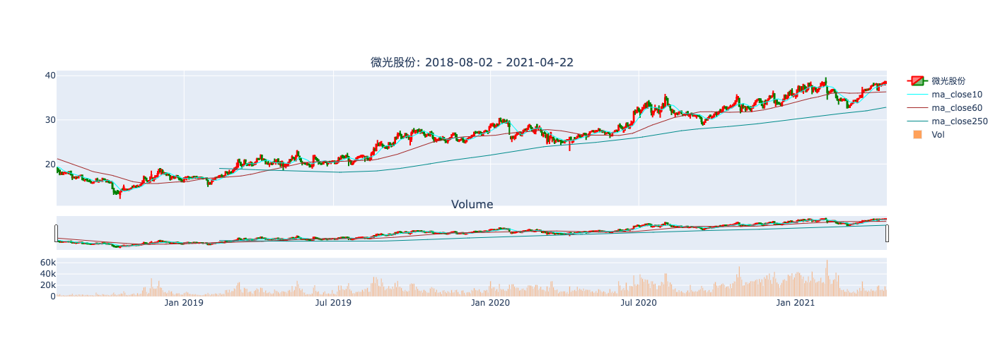

In [17]:
plot_k_plotly(df.loc['002801.SZ'], ma_spans=[10, 60, 250], height=500)

In [21]:
tdate = end_date
s=Strategy(name='xfe', stock_filter=StockFilter(tdate).not_st().zb())
s.add_condition('conseq_up_num', '=', val=1)
s.add_condition('conseq_up_num', '<', var='list_days')
s.add_condition('amount',  '<', val=2000000) # 15亿，unit: k
s.add_condition('circ_mv', '<', val=1000000) # 80亿，unit: w
s.add_condition('turnover_rate_f', '<', val=45)
s.add_condition('turnover_rate_f', '>=', val=7)
s.add_condition('high', '>', var='low', ratio=1.02) # 日内振幅大于 2% (非一字板）
s.add_condition('vol_ratio', '>', val=1.5)
s.add_condition('vol', '>', var='ma_vol_5', ratio=1.7)

tmp, _ = s.get_result(df=df, trade_date='2021-10-27')
check_performance(df=tmp)
# s.add_condition('next_open_pct', '>', val=0)

Searching 2021-10-27...


AttributeError: 'DataFrame' object has no attribute 'cvo'

In [ ]:
def (stra_name, tdate=None):
    stra = Strategy(name, StockFilter(tdate).not_st().zb())
    stra.rules = {}
    stra.add_condition('conseq_up_num', '>=', val=1)
    stra.add_condition('conseq_up_num', '<=', val=3)
    stra.add_condition('amount',  '<', val=2000000) # 15亿，unit: k
    stra.add_condition('circ_mv', '<', val=1000000) # 80亿，unit: w
    stra.add_condition('turnover_rate_f', '<', val=45)
    stra.add_condition('turnover_rate_f', '>=', val=7)
    stra.add_condition('high', '>', var='low', ratio=1.02) # 日内振幅大于 2% (非一字板）
    stra.add_condition('vol_ratio', '>', val=1.5)
    stra.add_condition('vol', '>', var='ma_vol_5', ratio=1.7)
    stra.add_condition('next_open_pct', '>', val=0)
    stra.add_condition('next_open_pct', '<', val=9)
    stra.add_condition('next_auc_amt_ratio', '>', val=0.04) # 竞价金额占昨日成交金额百分比 大于 4%
    stra.add_condition('next_auc_amt_ratio', '>', var='next_open_pct', ratio=0.01*3) # 竞价金额占昨日成交金额百分比 大于3倍 open_pct
    # stra.add_condition('next_auc_amt', '>', var='fd_amount', ratio=0.0002)
    stra.
    return stra


In [12]:
today_up.columns.to_list()

['open',
 'high',
 'low',
 'close',
 'pre_close',
 'change',
 'pct_chg',
 'vol',
 'amount',
 'adj_factor',
 'turnover_rate',
 'turnover_rate_f',
 'volume_ratio',
 'pe',
 'pe_ttm',
 'total_mv',
 'circ_mv',
 'total_share',
 'float_share',
 'free_share',
 'last_factor',
 'norm_adj',
 'adj_vol',
 'pre_close_4',
 'pre_close_6',
 'pre_close_11',
 'pre_close_21',
 'pre_pct_chg',
 'pre3_pct_chg',
 'pre5_pct_chg',
 'pre10_pct_chg',
 'pre20_pct_chg',
 'next_close_1',
 'next_close_2',
 'next_close_3',
 'next_close_10',
 'next_close_20',
 'next_pct_chg',
 'next2_pct_chg',
 'next3_pct_chg',
 'next10_pct_chg',
 'next20_pct_chg',
 'max_pre60_close',
 'max_pre120_close',
 'avg_price',
 'open_pct',
 'next_open_pct',
 'ma_vol_5',
 'ma_vol_20',
 'vol_ratio',
 'vol_ratio_long',
 'vol_type',
 'pre_vol_type',
 'pre_trf',
 'buy_sm_vol',
 'buy_md_vol',
 'buy_lg_vol',
 'buy_elg_vol',
 'sell_sm_vol',
 'sell_md_vol',
 'sell_lg_vol',
 'sell_elg_vol',
 'buy_sm_amount',
 'buy_md_amount',
 'buy_lg_amount',
 'buy_elg

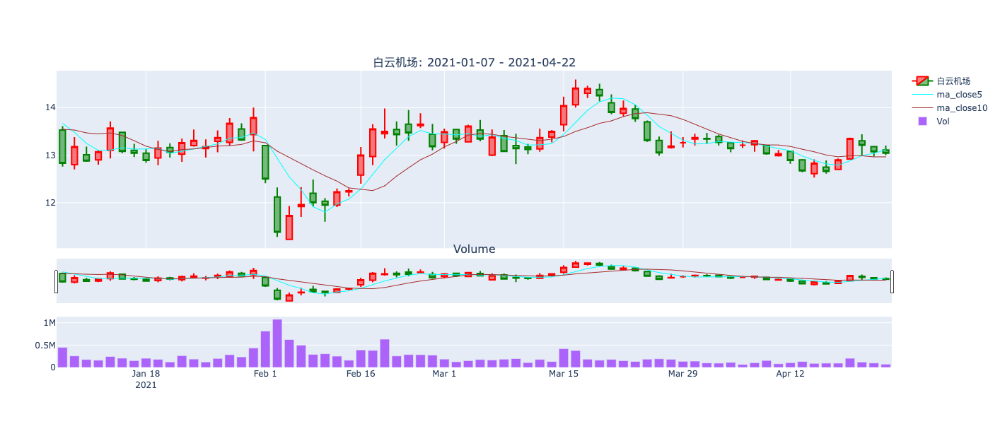

In [19]:
quick_k(code='600004.SH', df=df)

In [87]:
sumdf = pd.DataFrame(index=[tdate])
sumdf.loc[tdate,'wwfw']=1
sumdf

,wwfw
2021-08-18,1.0


In [91]:
up_cols = {
    'up1_cnt': '首板个股数',
    'up2_cnt': '二板个股数',
    'up3_cnt': '三板个股数',
    'ups_cnt': '连板个股数',
    'up1_conseq_rate': '一进二胜率',
    'up2_conseq_rate': '二进三胜率',
    'ups_conseq_rate': '总连板胜率',
    'up1_drop_pct_mean': '一进二掉队均涨幅',
    'up2_drop_pct_mean': '二进三掉队均涨幅',
    'pre_up1_pct_mean': '昨首板个股今平均涨幅',
    'pre_up2_pct_mean': '昨二板个股今平均涨幅',
    'pre_ups_pct_mean': '昨连板个股均涨幅',
    'max_conseq': '最高连板数',
}

def update_al(df, tdate, verbose=False):
    pre_date = tdu.past_trade_days(end_date=tdate)[-2]
    print(f'Working {tdate}, yesterday is {pre_date}...')
    
    tdf = df.xs(slice(tdate, tdate), level='trade_date', drop_level=True)
    tup_df = tdf[(tdf.conseq_up_num>=1) & (tdf.list_days != tdf.conseq_up_num)]    
    pre_df = df.xs(pre_date, level='trade_date', drop_level=True)
    
    sumdf = pd.DataFrame(index=[tdate])
    sumdf.loc[tdate, 'up1_cnt'] = len(tup_df[tup_df.conseq_up_num == 1])
    sumdf.loc[tdate, 'up2_cnt'] = len(tup_df[tup_df.conseq_up_num == 2])
    sumdf.loc[tdate, 'up3_cnt'] = len(tup_df[tup_df.conseq_up_num == 3])
    sumdf.loc[tdate, 'ups_cnt'] = len(tup_df[tup_df.conseq_up_num > 1])
    
    for i in [1, 2]:
        sumdf.loc[tdate, f'up{i}_conseq_rate'] = round(
            100 * len(tup_df[tup_df.conseq_up_num == i+1]) / len(pre_df[(pre_df.conseq_up_num == i) & (pre_df.list_days != pre_df.conseq_up_num)]), 2)
    sumdf.loc[tdate, 'ups_conseq_rate'] = round(
            100 * len(tup_df[tup_df.conseq_up_num >= 2]) / len(pre_df[(pre_df.conseq_up_num == i) & (pre_df.list_days != pre_df.conseq_up_num)]), 2)

    pre_up1_tdate_drop_df = tdf[(tdf.conseq_up_num==0) & (tdf.pre_conseq_up_num==1)]
    sumdf.loc[tdate, 'up1_drop_pct_mean'] = round(pre_up1_tdate_drop_df.pct_chg.mean(), 2)
    pre_up2_tdate_drop_df = tdf[(tdf.conseq_up_num==0) & (tdf.pre_conseq_up_num==2)]
    sumdf.loc[tdate, 'up2_drop_pct_mean'] = round(pre_up2_tdate_drop_df.pct_chg.mean(), 2)

    sumdf.loc[tdate, 'pre_up1_pct_mean'] = round(tdf[tdf.pre_conseq_up_num == 1].pct_chg.mean(), 2)
    sumdf.loc[tdate, 'pre_up2_pct_mean'] = round(tdf[tdf.pre_conseq_up_num == 2].pct_chg.mean(), 2)
    sumdf.loc[tdate, 'pre_ups_pct_mean'] = round(tdf[tdf.pre_conseq_up_num > 1].pct_chg.mean(), 2)
    
    sumdf.loc[tdate, 'max_conseq'] = tup_df.conseq_up_num.max()

    return pre_df, tdf, sumdf
    # today 1st

tdate = '2021-08-18'
sumdf = pd.DataFrame()
for tmpd in tdu.future_trade_days(start_date=tdate)[:20]:
    print(f'=============== {tmpd} =======================')
    pre_df, tdf, tmpdf = update_al(df, tmpd)
    sumdf = sumdf.append(tmpdf)

sumdf

=============== 2021-08-19 =======================
Working 2021-08-19, yesterday is 2021-08-18...
=============== 2021-08-20 =======================
Working 2021-08-20, yesterday is 2021-08-19...
=============== 2021-08-23 =======================
Working 2021-08-23, yesterday is 2021-08-20...
=============== 2021-08-24 =======================
Working 2021-08-24, yesterday is 2021-08-23...
=============== 2021-08-25 =======================
Working 2021-08-25, yesterday is 2021-08-24...
=============== 2021-08-26 =======================
Working 2021-08-26, yesterday is 2021-08-25...
=============== 2021-08-27 =======================
Working 2021-08-27, yesterday is 2021-08-26...
=============== 2021-08-30 =======================
Working 2021-08-30, yesterday is 2021-08-27...
=============== 2021-08-31 =======================
Working 2021-08-31, yesterday is 2021-08-30...
=============== 2021-09-01 =======================
Working 2021-09-01, yesterday is 2021-08-31...
=============== 2021

,up1_cnt,up2_cnt,up3_cnt,ups_cnt,up1_conseq_rate,up2_conseq_rate,ups_conseq_rate,up1_drop_pct_mean,up2_drop_pct_mean,pre_up1_pct_mean,pre_up2_pct_mean,pre_ups_pct_mean,max_conseq
2021-08-19,42.0,10.0,2.0,14.0,13.70,50.00,350.00,-1.27,0.60,-0.08,5.31,2.86,5.0
2021-08-20,48.0,5.0,3.0,10.0,11.90,30.00,100.00,0.26,0.47,0.95,2.82,2.50,6.0
2021-08-23,109.0,18.0,4.0,24.0,37.50,80.00,480.00,3.54,4.43,5.76,5.86,3.40,7.0
2021-08-24,59.0,14.0,6.0,24.0,12.84,33.33,133.33,1.52,0.26,2.57,3.22,2.48,8.0
2021-08-25,73.0,8.0,6.0,20.0,13.56,42.86,142.86,0.34,2.46,1.39,4.62,4.72,5.0
2021-08-26,59.0,8.0,1.0,16.0,10.96,12.50,200.00,0.12,0.52,1.07,1.09,2.55,6.0
2021-08-27,78.0,15.0,1.0,20.0,25.42,12.50,250.00,0.29,0.55,2.07,1.10,2.85,7.0
2021-08-30,74.0,17.0,8.0,30.0,21.79,53.33,200.00,1.78,1.42,3.34,4.69,4.78,8.0
2021-08-31,79.0,17.0,5.0,28.0,22.97,29.41,164.71,1.72,3.46,3.10,4.80,3.76,8.0
2021-09-01,62.0,14.0,3.0,21.0,17.72,17.65,123.53,-0.63,-2.79,1.13,-1.12,-0.32,8.0


In [94]:
plot_mline(df=sumdf, legend_labels=[
    'up1_cnt', 'up2_cnt', 'ups_cnt', 
    'up1_conseq_rate', 'up2_conseq_rate',
    'pre_up1_pct_mean', 'pre_up2_pct_mean', 'pre_ups_pct_mean'], title='连板趋势', y_label='xx')

In [90]:
tmpdf

,up1_cnt,up2_cnt,up3_cnt,ups_cnt,up1_conseq_rate,up2_conseq_rate,ups_conseq_rate,up1_drop_pct_mean,up2_drop_pct_mean,pre_up1_pct_mean,pre_up2_pct_mean,pre_ups_pct_mean,max_conseq
2021-09-15,NaN,NaN,NaN,NaN,5.66,66.67,116.67,0.57,-1.3,0.91,5.38,4.49,8.0


In [83]:
def update_al(df, tdate, verbose=False):
    sumdf = pd.DataFrame(index=[tdate])
    
    # pre_date = pdl.parse(tdate).add(days=-1).to_date_string()
    pre_date = tdu.past_trade_days(end_date=tdate)[-2]
    pre_df = df.xs(pre_date, level='trade_date', drop_level=True)
    
    print(f'Working {tdate}, yesterday is {pre_date}...')
    tdf = df.xs(slice(tdate, tdate), level='trade_date', drop_level=True)
    
    pre_up_df = pre_df[(pre_df.conseq_up_num>=1) & (pre_df.list_days != pre_df.conseq_up_num)]
    pre_ups_df = pre_df[(pre_df.conseq_up_num>1) & (pre_df.list_days != pre_df.conseq_up_num)]
    
    pre_up1_df = pre_df[(pre_df.conseq_up_num==1) & (pre_df.list_days != pre_df.conseq_up_num)]
    # pre_up1_stks = pre_up1_df.index.to_list()
    pre_up1_stks = intersection(tdf.index.to_list(), pre_up1_df.index.to_list())
    if verbose:
        print(', '.join(pre_up1_stks))
    pre_up1_tdate_pct_chg_avg  = round(tdf.loc[pre_up1_stks].pct_chg.mean(), 2)
    pre_up1_tdate_open_chg_avg = round(tdf.loc[pre_up1_stks].open_pct.mean(), 2)
    print(f'昨日首板今日开盘涨幅：{pre_up1_tdate_open_chg_avg}%，平均涨幅：{pre_up1_tdate_pct_chg_avg}%')

    tdate_up2_df = tdf[(tdf.conseq_up_num==2) & (tdf.list_days != tdf.conseq_up_num)]
    print(f'昨日首板今日晋级率: {round(len(tdate_up2_df)/len(pre_up1_df)*100, 1)}% ({len(tdate_up2_df)}/{len(pre_up1_df)})，开盘平均涨幅：{round(tdate_up2_df.open_pct.mean(),2)}%')
    
    pre_up1_tdate_drop_df = tdf[(tdf.conseq_up_num==0) & (tdf.pre_conseq_up_num==1)]
    print(f'昨日首板今日掉队股开盘涨幅：{round(pre_up1_tdate_drop_df.open_pct.mean(),2)}%，平均涨幅：{round(pre_up1_tdate_drop_df.pct_chg.mean(),2)}%')
   
    pre_up2_df = pre_df[(pre_df.conseq_up_num==2) & (pre_df.list_days != pre_df.conseq_up_num)]
    pre_up2_tdate_df = tdf.loc[pre_up2_df.index.to_list()]
    tdate_up3_df = tdf[(tdf.conseq_up_num==3) & (tdf.list_days != tdf.conseq_up_num)]
    # pre_up2_stks = 
    print(f'昨日二板今日晋级率: {round(len(tdate_up3_df)/len(pre_up2_df)*100, 1)}% ({len(tdate_up3_df)}/{len(pre_up2_df)})，开盘平均涨幅：{round(tdate_up3_df.open_pct.mean(),2)}%')
    
    pre_up2_tdate_drop_df = tdf[(tdf.conseq_up_num==0) & (tdf.pre_conseq_up_num==2)]
    print(f'昨日二板今日掉队股开盘涨幅：{round(pre_up2_tdate_drop_df.open_pct.mean(),2)}%，平均涨幅：{round(pre_up2_tdate_drop_df.pct_chg.mean(),2)}%')
   

    return pre_df, tdf, sumdf
    # today 1st

tdate = '2021-08-18'
for tmpd in tdu.future_trade_days(start_date=tdate)[:20]:
    print(f'=============== {tmpd} =======================')
    pre_df, tdf = update_al(df, tmpd)

=============== 2021-08-19 =======================
Working 2021-08-19, yesterday is 2021-08-18...
昨日首板今日开盘涨幅：1.61%，平均涨幅：-0.05%
昨日首板今日晋级率: 13.7% (10/73)，开盘平均涨幅：4.05%
昨日首板今日掉队股开盘涨幅：1.23%，平均涨幅：-1.27%
昨日二板今日晋级率: 50.0% (2/4)，开盘平均涨幅：4.95%
昨日二板今日掉队股开盘涨幅：5.19%，平均涨幅：0.6%
=============== 2021-08-20 =======================
Working 2021-08-20, yesterday is 2021-08-19...
昨日首板今日开盘涨幅：0.63%，平均涨幅：0.95%
昨日首板今日晋级率: 11.9% (5/42)，开盘平均涨幅：1.68%
昨日首板今日掉队股开盘涨幅：0.49%，平均涨幅：0.26%
昨日二板今日晋级率: 30.0% (3/10)，开盘平均涨幅：2.12%
昨日二板今日掉队股开盘涨幅：-0.09%，平均涨幅：0.47%
=============== 2021-08-23 =======================
Working 2021-08-23, yesterday is 2021-08-20...
昨日首板今日开盘涨幅：3.14%，平均涨幅：5.76%
昨日首板今日晋级率: 37.5% (18/48)，开盘平均涨幅：5.15%
昨日首板今日掉队股开盘涨幅：1.94%，平均涨幅：3.54%
昨日二板今日晋级率: 80.0% (4/5)，开盘平均涨幅：4.27%
昨日二板今日掉队股开盘涨幅：2.06%，平均涨幅：4.43%
=============== 2021-08-24 =======================
Working 2021-08-24, yesterday is 2021-08-23...
昨日首板今日开盘涨幅：2.64%，平均涨幅：2.57%
昨日首板今日晋级率: 12.8% (14/109)，开盘平均涨幅：5.25%
昨日首板今日掉队股开盘涨幅：2.26%，平均涨幅：1.52%
昨日二板今日晋级率: 33.3%

In [82]:
pre_df, tdf = update_al(df, '2021-08-30', verbose=True)

Working 2021-08-30, yesterday is 2021-08-27...
000032.SZ, 000153.SZ, 000422.SZ, 000546.SZ, 000635.SZ, 000683.SZ, 000815.SZ, 000820.SZ, 000822.SZ, 000833.SZ, 000971.SZ, 002009.SZ, 002021.SZ, 002048.SZ, 002057.SZ, 002113.SZ, 002125.SZ, 002132.SZ, 002135.SZ, 002218.SZ, 002240.SZ, 002241.SZ, 002268.SZ, 002274.SZ, 002312.SZ, 002323.SZ, 002340.SZ, 002411.SZ, 002490.SZ, 002497.SZ, 002504.SZ, 002539.SZ, 002592.SZ, 002619.SZ, 002640.SZ, 002681.SZ, 002759.SZ, 002895.SZ, 002897.SZ, 300262.SZ, 300488.SZ, 300490.SZ, 300505.SZ, 600007.SH, 600091.SH, 600096.SH, 600112.SH, 600126.SH, 600139.SH, 600146.SH, 600366.SH, 600367.SH, 600403.SH, 600408.SH, 600470.SH, 600518.SH, 600589.SH, 600602.SH, 600711.SH, 600739.SH, 600777.SH, 600804.SH, 600960.SH, 601117.SH, 601127.SH, 601388.SH, 601678.SH, 603033.SH, 603040.SH, 603069.SH, 603077.SH, 603286.SH, 603338.SH, 603396.SH, 603662.SH, 603718.SH, 603730.SH, 603897.SH


KeyError: "['600112.SH'] not in index"

In [ ]:
    
    # yesterday 1st
    
    
    # today 2nd
    today_df.loc[:, 'c_v_o'] = today_df.pct_chg - today_df.open_pct
    if backtest:
        back_test_cols = ['next_limit', 'next_pct_chg']
    else:
        back_test_cols = []
    raw_today_up = today_df[today_df.limit == 'U']
    return tdf

In [34]:
upstop_analyze(tdate=end_date, backtest=True, df=df, show_detail=True)

Showing upstop stocks on 2021-10-29...


KeyError: "['next_limit'] not in index"

In [35]:
df.loc['600004.SH'][[
    'close',
    'ma_close_5',
    'ma_close_10',
    'ma_close_30',
    'ma_close_60',
    'ma_close_120',
    'ma_close_250',
    'turnover_rate_f',
    'limit',
    'vol',
    'conseq_up_num',
    'amount',
    'pct_chg'
]].tail(50).head(5)

,close,ma_close_5,ma_close_10,ma_close_30,ma_close_60,ma_close_120,ma_close_250,turnover_rate_f,limit,vol,conseq_up_num,amount,pct_chg
trade_date,,,,,,,,,,,,,
2021-08-12,8.70,8.638,8.628,9.676333,10.608833,11.785167,12.87308,1.4652,None,148415.88,0,130313.055,-1.1312
2021-08-13,8.74,8.712,8.631,9.602667,10.555167,11.745583,12.85216,0.8513,None,86233.82,0,75319.516,0.4598
2021-08-16,9.08,8.798,8.677,9.545000,10.508000,11.709250,12.83284,2.5849,None,261846.89,0,233946.420,3.8902
2021-08-17,8.96,8.856,8.704,9.482000,10.458167,11.672500,12.81244,4.1099,None,416320.06,0,382284.800,-1.3216
2021-08-18,9.12,8.920,8.759,9.424333,10.408833,11.636750,12.79172,1.8154,None,183892.77,0,167254.080,1.7857


In [13]:


df.loc[:, 'bar_type'] = df.apply(f_calc_yinyang, axis=1)
df.loc[:, 'pre_bar_type'] = df.groupby('ts_code').bar_type.shift(1)
df.loc[:, 'pre2_bar_type'] = df.groupby('ts_code').bar_type.shift(2)
df.loc[:, 'pre2_pct_chg'] = df.groupby('ts_code').pct_chg.shift(2)
df.loc[:, 'pre2_conseq_up_num'] = df.groupby('ts_code').conseq_up_num.shift(2)
df.loc[:, 'pre2_close'] = df.groupby('ts_code').close.shift(2)

### Strategy Test Area

In [8]:
', '.join(df.columns.to_list())

'open, high, low, close, pre_close, change, pct_chg, vol, amount, adj_factor, turnover_rate, turnover_rate_f, volume_ratio, pe, pe_ttm, total_mv, circ_mv, total_share, float_share, free_share, last_factor, norm_adj, adj_vol, pre_close_4, pre_close_6, pre_close_11, pre_close_21, pre_pct_chg, pre3_pct_chg, pre5_pct_chg, pre10_pct_chg, pre20_pct_chg, next_close_1, next_close_2, next_close_3, next_close_10, next_close_20, next_pct_chg, next2_pct_chg, next3_pct_chg, next10_pct_chg, next20_pct_chg, max_pre60_close, max_pre120_close, avg_price, open_pct, next_open_pct, ma_vol_5, ma_vol_20, vol_ratio, vol_ratio_long, vol_type, pre_vol_type, pre_trf, buy_sm_vol, buy_md_vol, buy_lg_vol, buy_elg_vol, sell_sm_vol, sell_md_vol, sell_lg_vol, sell_elg_vol, buy_sm_amount, buy_md_amount, buy_lg_amount, buy_elg_amount, sell_sm_amount, sell_md_amount, sell_lg_amount, sell_elg_amount, net_mf_vol, net_mf_amount, amp, fc_ratio, fl_ratio, fd_amount, first_time, last_time, open_times, strth, limit, name, list

In [38]:
# 近期大热，2 阴线洗盘
t1 = Strategy('double_yin', StockFilter(end_date).not_st().zb())
# t1.add_condition('bar_type', '=', 'yin')
# t1.add_condition('pre_bar_type', '=', 'yin')
# t1.add_condition('close', '>', var='pre2_close')
# t1.add_condition('pre_close', '>', var='pre2_close')
# t1.add_condition('pre2_conseq_up_num', '=', 2)
# t1.add_condition('pre2_conseq_up_num', '<=', 2)
# t1.add_condition('vol_ratio', '>=', 1)
# t1.add_condition('vol_ratio', '<=', 1.3)
t1.add_condition('conseq_up_num', '=', 2)

In [39]:
res, keys = t1.get_result(df)
res_dict = sum_diff(df, res)
pd.DataFrame(data=res_dict)

,next_open_pct_mean,next_pct_chg_mean,next2_pct_chg_mean,next_up_rate,next2_up_rate
Original,-0.062744,0.065268,0.132432,0.474438,0.473310
Filtered,3.180017,2.344255,2.700609,0.605848,0.543435


In [33]:
res1 = res.sort_index(level='trade_date').tail(20)[['name', 'vol_ratio', 'pct_chg', 'bar_type', 'pre_pct_chg', 'pre_bar_type', 'pre2_pct_chg', 'next_open_pct', 'next_pct_chg', 'next2_pct_chg']]
style_df(res1)

,,name,vol_ratio,pct_chg,bar_type,pre_pct_chg,pre_bar_type,pre2_pct_chg,next_open_pct,next_pct_chg,next2_pct_chg
ts_code,trade_date,,,,,,,,,,
002626.SZ,2020-07-24 00:00:00,金达威,1.48,-4.23%,yin,6.404300,yin,10.004400,0.458990,-8.6%,0.539%
600331.SH,2020-07-31 00:00:00,宏达股份,1.86,-4.44%,yin,6.545500,yin,10.000000,-0.714286,0.0%,-5.71%
603959.SH,2020-08-19 00:00:00,百利科技,1.02,-0.822%,yin,1.388900,yin,9.979600,-1.749540,-0.645%,1.57%
603167.SH,2020-08-20 00:00:00,渤海轮渡,1.57,-5.71%,yin,7.391000,yin,10.006900,-0.189633,9.99%,20.9%
600586.SH,2020-12-16 00:00:00,金晶科技,1.9,-4.85%,yin,8.027900,yin,9.980800,-2.896082,4.43%,1.36%
601901.SH,2021-01-05 00:00:00,方正证券,2.9,-7.4%,yin,8.100300,yin,9.968200,-2.217936,-4.05%,-5.59%
002375.SZ,2021-01-13 00:00:00,亚厦股份,1.6,-2.24%,yin,4.556700,yin,10.027100,-3.260870,1.09%,5.8%
600111.SH,2021-01-25 00:00:00,北方稀土,1.48,-1.58%,yin,4.571400,yin,9.993700,-2.729805,4.85%,-0.0557%
600549.SH,2021-02-19 00:00:00,厦门钨业,1.32,-1.46%,yin,8.641400,yin,9.978900,3.750565,-2.39%,-0.0904%


In [40]:
# T 字板
t1 = Strategy('t1', StockFilter(end_date).not_st())
t1.add_condition('up_type', '=', 'T')
t1.add_condition('conseq_up_num', '>', 1)
t1.add_condition('', '')
# t1.add_condition('next_open_pct', '<', 5)
# t1.add_condition('next_open_pct', '>', 0)
t1.add_condition('close', '<', var='ma_close_250', ratio=1.5)
res, keys = t1.get_result(df)

In [16]:
def back_test(strat, df):
    res, keys = t1.get_result(df)
    res_dict = sum_diff(df, res)
    display(pd.DataFrame(data=res_dict))
    res1 = res.sort_index(level='trade_date').tail(20)[['name', 'vol_ratio', 'close', 'ma_close_10', 'ma_close_250', 'turnover_rate_f', 'pct_chg', 'pre_pct_chg', 'pre_bar_type', 'next_open_pct', 'next_pct_chg', 'next2_pct_chg']]
    display(style_df(res1))
    return res

#### 1.  大活跃

In [57]:
big_rage_stra = Strategy('big_rage', StockFilter(end_date).not_st().zb())
big_rage_stra.rules = {}
big_rage_stra.add_condition('pre10_upstops', '>', 1)
big_rage_stra.add_condition('pre10_upstops', '<', 4)
big_rage_stra.add_condition('pct_chg', '>', 0)
big_rage_stra.add_condition('pct_chg', '<', 5)
big_rage_stra.add_condition('close', '>', var='ma_close_5')
big_rage_stra.add_condition('ma_close_5', '>', var='pre_ma_close_5')
big_rage_stra.add_condition('pre_ma_close_5', '>', var='pre2_ma_close_5')
big_rage_stra.add_condition('pre2_ma_close_5', '>', var='pre3_ma_close_5')
big_rage_stra.add_condition('vol_ratio', '<', 1)
big_rage_stra.add_condition('close', '<', var='ma_close_10', ratio=1.3)

In [58]:
res, keys = big_rage_stra.get_result(df)
res_dict = sum_diff(df, res)
pd.DataFrame(data=res_dict)

,next_open_pct_mean,next_pct_chg_mean,next2_pct_chg_mean,next_up_rate,next2_up_rate
Original,-0.062744,0.065268,0.132432,0.474438,0.473310
Filtered,-0.307690,-0.273811,-0.211400,0.427078,0.428646


In [59]:
res1 = res.sort_index(level='trade_date').tail(30)[['name', 'vol_ratio', 'close', 'ma_close_10', 'ma_close_250', 'turnover_rate_f', 'pct_chg', 'pre_pct_chg', 'pre_bar_type', 'next_open_pct', 'next_pct_chg', 'next2_pct_chg']]
style_df(res1)

,,name,vol_ratio,close,ma_close_10,ma_close_250,turnover_rate_f,pct_chg,pre_pct_chg,pre_bar_type,next_open_pct,next_pct_chg,next2_pct_chg
ts_code,trade_date,,,,,,,,,,,,
603922.SH,2021-10-20 00:00:00,金鸿顺,0.44,24.180000,22.224000,16.679920,7.89%,0.124%,-2.147500,cross,-0.082713,3.76%,14.1%
002114.SZ,2021-10-21 00:00:00,罗平锌电,0.82,9.590000,8.707000,7.186720,10.8%,2.13%,-0.949400,yang,-1.459854,-3.65%,-5.11%
002368.SZ,2021-10-21 00:00:00,太极股份,0.965,28.770000,28.078000,23.783600,5.38%,0.559%,-2.620800,yin,-0.034758,0.382%,-0.417%
002790.SZ,2021-10-21 00:00:00,瑞尔特,0.852,6.800000,6.415000,5.613440,7.7%,3.98%,0.615400,cross,0.000000,4.12%,1.91%
002824.SZ,2021-10-21 00:00:00,和胜股份,0.568,39.030000,35.557000,24.486520,6.21%,0.257%,-0.714100,yin,-1.998463,-3.1%,-3.72%
002881.SZ,2021-10-21 00:00:00,美格智能,0.826,36.330000,32.586000,23.490600,12.3%,1.03%,-0.332600,yin,-0.522984,1.82%,0.33%
002935.SZ,2021-10-21 00:00:00,天奥电子,0.932,27.600000,24.969000,22.689240,6.87%,1.1%,-0.727300,cross,1.231884,-2.68%,-3.08%
603922.SH,2021-10-21 00:00:00,金鸿顺,0.907,25.090000,22.982000,16.710360,13.9%,3.76%,0.124200,yang,0.159426,10.0%,21.0%
603978.SH,2021-10-21 00:00:00,深圳新星,0.812,37.150000,32.892000,19.301640,10.2%,4.65%,2.187700,yang,-0.403769,-7.13%,-3.1%


In [28]:
# 300大涨次日大跌
t1 = Strategy('300up&down', StockFilter(end_date).not_st().cyb())
t1.add_condition('open', '<', var='pre_close', ratio=0.98)
t1.add_condition('open', '>', var='close', ratio=1.05)
t1.add_condition('high', '<', var='pre_close')
t1.add_condition('pre_pct_chg', '>', 14)
t1.add_condition('pct_chg', '<', -6)
t1.add_condition('next_open_pct', '>', 0)
t1.add_condition('next_open_pct', '<', 3)
# test
res, keys = t1.get_result(df)
res_dict = sum_diff(df, res)
pd.DataFrame(data=res_dict)

,next_open_pct_mean,next_pct_chg_mean,next2_pct_chg_mean,next_up_rate,next2_up_rate
Original,-0.062744,0.065268,0.132432,0.474438,0.47331
Filtered,0.930205,3.153371,3.944518,0.750000,0.60000


In [29]:
res1 = res.sort_index(level='trade_date').tail(30)[['name'] + keys + ['vol_ratio', 'turnover_rate_f', 'next_pct_chg', 'next2_pct_chg']]
style_df(res1)

,,name,open,high,pre_pct_chg,pct_chg,next_open_pct,vol_ratio,turnover_rate_f,next_pct_chg,next2_pct_chg
ts_code,trade_date,,,,,,,,,,
300410.SZ,2020-09-09 00:00:00,正业科技,10.750000,10.990000,14.153800,-14.2%,1.151832,1.15,25.2%,-10.9%,-7.12%
300116.SZ,2020-09-24 00:00:00,保力新,3.760000,3.870000,17.910400,-11.6%,1.719198,1.12,9.12%,3.15%,7.45%
300288.SZ,2020-09-24 00:00:00,朗玛信息,15.690000,15.780000,19.985400,-10.0%,0.202840,2.25,25.7%,0.541%,-3.25%
300485.SZ,2020-09-24 00:00:00,赛升药业,20.700000,20.960000,20.011100,-9.26%,1.071429,2.18,26.5%,5.15%,7.86%
300086.SZ,2020-10-23 00:00:00,康芝药业,8.320000,8.520000,16.553600,-8.03%,1.143583,1.64,32.9%,3.81%,7.62%
300350.SZ,2020-11-13 00:00:00,华鹏飞,8.000000,8.100000,19.941300,-8.56%,1.069519,1.13,30.3%,2.67%,7.49%
300613.SZ,2021-02-03 00:00:00,富瀚微,107.310000,107.980000,18.446600,-7.1%,1.500294,0.747,8.0%,-2.22%,-7.72%
300234.SZ,2021-05-17 00:00:00,开尔新材,8.080000,8.160000,19.635300,-11.6%,2.393617,1.31,29.3%,4.12%,10.1%
300309.SZ,2021-05-17 00:00:00,吉艾科技,2.470000,2.570000,20.183500,-13.4%,0.440529,2.64,16.0%,19.4%,22.5%


#### 2. 涨停类型

In [3]:
ups = df[df.conseq_up_num>=1].xs(end_date, level='trade_date').sort_values('conseq_up_num', ascending=False)

In [31]:
up_hist = df[df.conseq_up_num>=1]

In [34]:

up_hist[up_hist.turnover_rate_f<60].next_pct_chg.mean()

1.9833628029882502

In [4]:
from utils.strategy import Strategy

In [5]:
stra = Strategy('test', df)

In [28]:
stra.rules={}

In [29]:
stra.add_condition('pre_conseq_up_num', '=', val=2)

In [30]:
stra.add_condition('pre_trf', '<', val=30)
stra.add_condition('pre_trf', '>', val=5)

In [9]:
stra.add_condition('open_pct', '>', val=2)
stra.add_condition('open_pct', '<', val=3)

In [31]:
stra.add_condition('list_days', '>', var='conseq_up_num')

In [32]:
stra.rules

{'pre_conseq_up_num': [{'op': '=', 'val': 2}],
 'pre_trf': [{'op': '<', 'val': 30}, {'op': '>', 'val': 5}],
 'list_days': [{'op': '>', 'var': 'conseq_up_num'}]}

全体平均涨幅：2.14%，非一字板平均涨幅：2.05%
Y类板占比：2.0%，平均涨幅：6.06%
T类板占比：10.0%，平均涨幅：1.96%
H类板占比：2.0%，平均涨幅：0.44%
W类板占比：16.0%，平均涨幅：2.51%
L类板占比：9.0%，平均涨幅：2.56%
O类板占比：62.0%，平均涨幅：1.93%
M类板占比：0.0%，平均涨幅：nan%
跌停票占比：4.0%，涨停票占比：29.0%


open    high     low   close  pre_close  change  \
ts_code   trade_date                                                      
000004.SZ 2021-06-11   23.98   23.98   23.68   23.98      21.80    2.18   
          2021-07-14   22.00   24.90   21.56   22.80      22.64    0.16   
000007.SZ 2021-02-22    3.14    3.36    3.14    3.36       3.05    0.31   
          2021-03-10    4.39    4.82    4.07    4.37       4.38   -0.01   
          2021-06-24    4.04    4.13    3.92    3.95       3.97   -0.02   
...                      ...     ...     ...     ...        ...     ...   
688316.SH 2021-06-02   90.00  106.19   88.49   95.32      88.49    6.83   
688357.SH 2021-10-18  185.53  192.88  181.00  187.79     187.86   -0.07   
688663.SH 2021-08-02   39.00   42.50   36.79   37.70      36.00    1.70   
688699.SH 2021-04-27  137.86  138.44  116.09  124.38     136.36  -12.04   
          2021-07-02  390.40  410.86  377.00  384.75     342.38   42.37   

                      pct_chg        vol       amount  adj_factor  \
ts_code   trade_date                                                
000004.SZ 2021-06-11  10.0000   56161.45   134672.950       4.064   
          2021-07-14   0.7067  262125.33   595037.600       4.064   
000007.SZ 2021-02-22  10.1639  183718.62    59913.582       8.284   
          2021-03-10  -0.2283  981915.70   445540.840       8.284   
          2021-06-24  -0.5038  144224.80    57619.656       8.284   
...                       ...        ...          ...         ...   
688316.SH 2021-06-02   7.7184   38686.67   388063.440       1.000   
688357.SH 2021-10-18  -0.0373   20708.57   386964.380       1.020   
688663.SH 2021-08-02   4.7222  164926.80   649362.060       1.014   
688699.SH 2021-04-27  -8.7858   53321.60   669799.750       1.000   
          2021-07-02  12.3751   63901.97  2518739.000       1.005   

                      turnover_rate  turnover_rate_f  volume_ratio        pe  \
ts_code   trade_date                                                           
000004.SZ 2021-06-11         4.8783           6.1548          0.62   61.2468   
          2021-07-14        22.7686          28.7268          3.09   58.2330   
000007.SZ 2021-02-22         5.9466           8.5120          0.90   52.2295   
          2021-03-10        31.7826          45.4940          1.58   67.9294   
          2021-06-24         4.6683           5.6001          2.39       NaN   
...                             ...              ...           ...       ...   
688316.SH 2021-06-02        35.7049          35.7049          3.67       NaN   
688357.SH 2021-10-18         7.8839           8.9609          2.46   85.2474   
688663.SH 2021-08-02        54.7069          54.7069          2.72   49.4393   
688699.SH 2021-04-27        31.5246          31.5246          3.04   85.0761   
          2021-07-02        36.1797          36.1797          3.58  261.8642   

                        pe_ttm    total_mv    circ_mv  total_share  \
ts_code   trade_date                                                 
000004.SZ 2021-06-11   60.7922   395796.20  276071.25   16505.2620   
          2021-07-14   57.8007   376320.00  262486.40   16505.2620   
000007.SZ 2021-02-22       NaN   116406.54  103806.54   34644.8050   
          2021-03-10       NaN   151397.80  135010.30   34644.8050   
          2021-06-24       NaN   136846.98  122034.48   34644.8050   
...                        ...         ...        ...          ...   
688316.SH 2021-06-02       NaN   452409.44  103280.42    4746.2173   
688357.SH 2021-10-18   60.8519  1085801.80  493268.00    5782.0000   
688663.SH 2021-08-02   44.3147   527611.50  113655.49   13995.0000   
688699.SH 2021-04-27   57.5616   929600.00  211428.86    7436.8000   
          2021-07-02  177.1747  2861308.80  679560.80    7436.8000   

                      float_share  free_share  last_factor  norm_adj  \
ts_code   trade_date                                                   
000004.SZ 2021-06-11   11512.5620   9124.7560        4

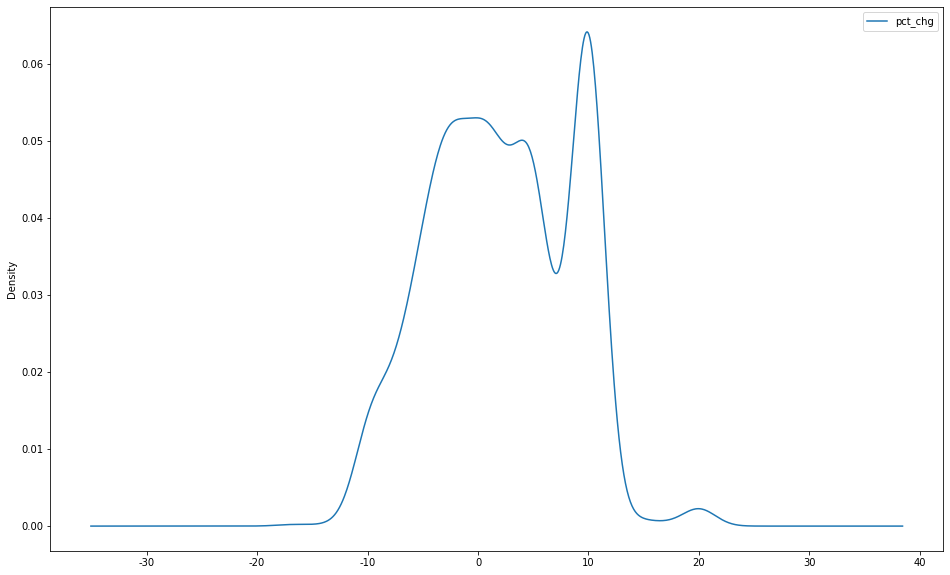

In [33]:
res, keys = stra.get_result()
show_upstop_stat(res)

In [35]:
res.open_pct.mean()

2.7348363371340088

In [3]:
# plot stuff

from utils.env_plt import *

In [26]:
sf = StockFilter(end_date=end_date)

In [50]:
df1 = sf.not_new().not_st().cyb().filter(df)
df1

open   high    low  close  pre_close  change  pct_chg  \
ts_code   trade_date                                                           
300001.SZ 2020-09-09  19.96  20.06  19.28  19.31      20.09   -0.78  -3.8748   
          2020-09-10  19.46  19.60  17.77  17.98      19.31   -1.34  -6.9251   
          2020-09-11  17.86  18.48  17.29  18.41      17.98    0.43   2.3876   
          2020-09-14  18.57  18.81  18.22  18.62      18.41    0.21   1.1388   
          2020-09-15  18.70  18.70  18.23  18.39      18.62   -0.23  -1.2332   
...                     ...    ...    ...    ...        ...     ...      ...   
300999.SZ 2021-09-17  67.85  69.29  66.83  68.30      68.21    0.09   0.1319   
          2021-09-22  67.13  67.99  66.82  66.98      68.30   -1.32  -1.9327   
          2021-09-23  66.95  68.10  66.90  67.17      66.98    0.19   0.2837   
          2021-09-24  67.30  71.72  67.18  69.75      67.17    2.58   3.8410   
          2021-09-27  69.10  75.60  69.10  73.25      69.75    3.50   5.0179   

                            vol      amount  adj_factor  turnover_rate  \
ts_code   trade_date                                                     
300001.SZ 2020-09-09  135646.08   266709.00       6.921         1.4358   
          2020-09-10  240768.03   443505.00       6.921         2.5486   
          2020-09-11  151875.53   272332.94       6.921         1.6076   
          2020-09-14   86494.82   160439.89       6.921         0.9156   
          2020-09-15   72857.69   134183.72       6.921         0.7712   
...                         ...         ...         ...            ...   
300999.SZ 2021-09-17  110430.44   751482.75       1.001         2.7910   
          2021-09-22   63016.03   422795.70       1.001         1.5927   
          2021-09-23   62266.99   418978.30       1.001         1.5737   
          2021-09-24  209837.11  1467635.50       1.001         5.3035   
          2021-09-27  282900.94  2067810.80       1.001         7.1501   

                      turnover_rate_f  volume_ratio       pe   pe_ttm  \
ts_code   trade_date                                                    
300001.SZ 2020-09-09           2.5463          0.75  71.4367  97.4154   
          2020-09-10           4.5197          1.65  66.4897  90.6693   
          2020-09-11           2.8510          0.99  68.0772  92.8341   
          2020-09-14           1.6237          0.57  68.8525  93.8913   
          2020-09-15           1.3677          0.50  68.0033  92.7334   
...                               ...           ...      ...      ...   
300999.SZ 2021-09-17           2.7910          1.12  61.7068  62.0937   
          2021-09-22           1.5927          0.61  60.5142  60.8936   
          2021-09-23           1.5737          0.63  60.6859  61.0663   
          2021-09-24           5.3035          2.24  63.0168  63.4119   
          2021-09-27           7.1501          2.43  66.1790  66.5939   

                        total_mv    circ_mv  total_share  float_share  \
ts_code   trade_date                                                    
300001.SZ 2020-09-09   1930298.1  1828039.9     99757.01     94472.34   
          2020-09-10   1796623.8  1701447.0     99757.01     94472.34   
          2020-09-11   1839519.2  1742070.0     99757.01     94472.34   
          2020-09-14   1860468.2  1761909.2     99757.01     94472.34   
          2020-09-15   1837524.1  1740180.6     99757.01     94472.34   
...                          ...        ...          ...          ...   
300999.SZ 2021-09-17  37029472.0  2702361.2    542159.10     39566.05   
          2021-09-22  36313820.0  2650134.0    542159.10     39566.05   
          2021-09-23  36416832.0  2657651.8    542159.10     39566.05   
          2021-09-24  37815600.0  2759732.0    542159.10     39566.05   
          2021-09-27  39713160.0  2898213.2    542159.10     39566.05   

                      free_share  last_factor  pre_close_4  pre_close_6  \
ts_code   trade_date                        

In [51]:
df2 = df1.loc['300502.SZ']
df2.name

trade_date
2020-09-09    新易盛
2020-09-10    新易盛
2020-09-11    新易盛
2020-09-14    新易盛
2020-09-15    新易盛
             ... 
2021-09-17    新易盛
2021-09-22    新易盛
2021-09-23    新易盛
2021-09-24    新易盛
2021-09-27    新易盛
Name: name, Length: 255, dtype: object

In [54]:
df2['avg_price'] = cn_round_price(df2.amount * 10 / df2.vol)
df2.avg_price

trade_date
2020-09-09    60.24
2020-09-10    58.75
2020-09-11    58.46
2020-09-14    61.21
2020-09-15    62.34
              ...  
2021-09-17    32.77
2021-09-22    32.55
2021-09-23    33.46
2021-09-24    32.86
2021-09-27    33.99
Name: avg_price, Length: 255, dtype: float64

In [80]:
df1.loc[:,f'adj_vol'] = (df1.vol/df1.norm_adj).apply(lambda p: cn_round_price(p))

In [49]:
df.loc[:, 'norm_adj'] =  df.adj_factor / df.last_factor

In [107]:
def gen_vwap(df, spans=None):
    if not spans:
        spans = [5, 10]
    for span in spans:
        vol_in_span = df.groupby(level='ts_code').adj_vol.apply(lambda x: x.rolling(window=span).sum())
        amt_in_span = df.groupby(level='ts_code').amount.apply(lambda x: x.rolling(window=span).sum())
        
        df.loc[:, f'vwap_{span}'] = (amt_in_span/vol_in_span).apply(lambda p: cn_round_price(p*10))
#         x = (amt_in_span/vol_in_span).apply(lambda p: cn_round_price(p*10))
#     return vol_in_span, amt_in_span, x
    return df
df2 = gen_vwap(df1, spans=[5, 10, 30])

In [109]:
from utils.stock_utils import *

open   high    low  close  pre_close  change  pct_chg  \
ts_code   trade_date                                                           
300001.SZ 2020-09-09  19.96  20.06  19.28  19.31      20.09   -0.78  -3.8748   
          2020-09-10  19.46  19.60  17.77  17.98      19.31   -1.34  -6.9251   
          2020-09-11  17.86  18.48  17.29  18.41      17.98    0.43   2.3876   
          2020-09-14  18.57  18.81  18.22  18.62      18.41    0.21   1.1388   
          2020-09-15  18.70  18.70  18.23  18.39      18.62   -0.23  -1.2332   
...                     ...    ...    ...    ...        ...     ...      ...   
300999.SZ 2021-09-17  67.85  69.29  66.83  68.30      68.21    0.09   0.1319   
          2021-09-22  67.13  67.99  66.82  66.98      68.30   -1.32  -1.9327   
          2021-09-23  66.95  68.10  66.90  67.17      66.98    0.19   0.2837   
          2021-09-24  67.30  71.72  67.18  69.75      67.17    2.58   3.8410   
          2021-09-27  69.10  75.60  69.10  73.25      69.75    3.50   5.0179   

                            vol      amount  adj_factor  turnover_rate  \
ts_code   trade_date                                                     
300001.SZ 2020-09-09  135646.08   266709.00       6.921         1.4358   
          2020-09-10  240768.03   443505.00       6.921         2.5486   
          2020-09-11  151875.53   272332.94       6.921         1.6076   
          2020-09-14   86494.82   160439.89       6.921         0.9156   
          2020-09-15   72857.69   134183.72       6.921         0.7712   
...                         ...         ...         ...            ...   
300999.SZ 2021-09-17  110430.44   751482.75       1.001         2.7910   
          2021-09-22   63016.03   422795.70       1.001         1.5927   
          2021-09-23   62266.99   418978.30       1.001         1.5737   
          2021-09-24  209837.11  1467635.50       1.001         5.3035   
          2021-09-27  282900.94  2067810.80       1.001         7.1501   

                      turnover_rate_f  volume_ratio       pe   pe_ttm  \
ts_code   trade_date                                                    
300001.SZ 2020-09-09           2.5463          0.75  71.4367  97.4154   
          2020-09-10           4.5197          1.65  66.4897  90.6693   
          2020-09-11           2.8510          0.99  68.0772  92.8341   
          2020-09-14           1.6237          0.57  68.8525  93.8913   
          2020-09-15           1.3677          0.50  68.0033  92.7334   
...                               ...           ...      ...      ...   
300999.SZ 2021-09-17           2.7910          1.12  61.7068  62.0937   
          2021-09-22           1.5927          0.61  60.5142  60.8936   
          2021-09-23           1.5737          0.63  60.6859  61.0663   
          2021-09-24           5.3035          2.24  63.0168  63.4119   
          2021-09-27           7.1501          2.43  66.1790  66.5939   

                        total_mv    circ_mv  total_share  float_share  \
ts_code   trade_date                                                    
300001.SZ 2020-09-09   1930298.1  1828039.9     99757.01     94472.34   
          2020-09-10   1796623.8  1701447.0     99757.01     94472.34   
          2020-09-11   1839519.2  1742070.0     99757.01     94472.34   
          2020-09-14   1860468.2  1761909.2     99757.01     94472.34   
          2020-09-15   1837524.1  1740180.6     99757.01     94472.34   
...                          ...        ...          ...          ...   
300999.SZ 2021-09-17  37029472.0  2702361.2    542159.10     39566.05   
          2021-09-22  36313820.0  2650134.0    542159.10     39566.05   
          2021-09-23  36416832.0  2657651.8    542159.10     39566.05   
          2021-09-24  37815600.0  2759732.0    542159.10     39566.05   
          2021-09-27  39713160.0  2898213.2    542159.10     39566.05   

                      free_share  last_factor  pre_close_4  pre_close_6  \
ts_code   trade_date                        

In [111]:
df2['2021-05-01':'2021-09-27'][['adj_factor', 'close', 'vwap_5', 'vwap_30']]

,,adj_factor,close,vwap_5,vwap_30
ts_code,trade_date,,,,


In [105]:
df1.groupby(level='ts_code').pct_chg.apply(lambda x: x.rolling(window=5).sum())

ts_code    trade_date
300001.SZ  2020-09-09       NaN
           2020-09-10       NaN
           2020-09-11       NaN
           2020-09-14       NaN
           2020-09-15   -8.5067
                          ...  
300999.SZ  2021-09-17   -0.4439
           2021-09-22   -0.2493
           2021-09-23    0.6746
           2021-09-24    3.7514
           2021-09-27    7.3418
Name: pct_chg, Length: 228044, dtype: float64

In [104]:
x.drop(index='ts_code')

KeyError: 'ts_code'

In [100]:
df1.groupby(level='ts_code').adj_vol.rolling(window=5).max()

ts_code    ts_code    trade_date
300001.SZ  300001.SZ  2020-09-09          NaN
                      2020-09-10          NaN
                      2020-09-11          NaN
                      2020-09-14          NaN
                      2020-09-15    241220.27
                                      ...    
300999.SZ  300999.SZ  2021-09-17    135627.55
                      2021-09-22    135627.55
                      2021-09-23    135627.55
                      2021-09-24    209837.11
                      2021-09-27    282900.94
Name: adj_vol, Length: 228044, dtype: float64

In [32]:
def gen_ichimoku(df):   
    nine_period_high = df['high'].rolling(window=9).max()
    nine_period_low = df['low'].rolling(window=9).min()
    df['tenkan_sen'] = (nine_period_high + nine_period_low)/2
    
    # Kijun-sen (Base Line): (26-period high + 26-period low)/2))
    period26_high = df['high'].rolling(window=26).max()
    period26_low = df['low'].rolling(window=26).min()
    df['kijun_sen'] = (period26_high + period26_low) / 2
    
    # Senkou Span A (Leading Span A): (Conversion Line + Base Line)/2))
    df['senkou_span_a'] = ((df['tenkan_sen'] + df['kijun_sen']) / 2).shift(26)
    
    # Senkou Span B (Leading Span B): (52-period high + 52-period low)/2))
    period52_high = df['high'].rolling(window=52).max()
    period52_low = df['low'].rolling(window=52).min()
    df['senkou_span_b'] = ((period52_high + period52_low) / 2).shift(26)
    
    # The most current closing price plotted 26 time periods behind (optional)
    df['chikou_span'] = df['close'].shift(-26)
    
    # create a quick plot of the results to see what we have created
    return df
    
df2 = gen_ichimoku(df2)

In [113]:
df2

open   high    low  close  pre_close  change  pct_chg  \
ts_code   trade_date                                                           
300001.SZ 2020-09-09  19.96  20.06  19.28  19.31      20.09   -0.78  -3.8748   
          2020-09-10  19.46  19.60  17.77  17.98      19.31   -1.34  -6.9251   
          2020-09-11  17.86  18.48  17.29  18.41      17.98    0.43   2.3876   
          2020-09-14  18.57  18.81  18.22  18.62      18.41    0.21   1.1388   
          2020-09-15  18.70  18.70  18.23  18.39      18.62   -0.23  -1.2332   
...                     ...    ...    ...    ...        ...     ...      ...   
300999.SZ 2021-09-17  67.85  69.29  66.83  68.30      68.21    0.09   0.1319   
          2021-09-22  67.13  67.99  66.82  66.98      68.30   -1.32  -1.9327   
          2021-09-23  66.95  68.10  66.90  67.17      66.98    0.19   0.2837   
          2021-09-24  67.30  71.72  67.18  69.75      67.17    2.58   3.8410   
          2021-09-27  69.10  75.60  69.10  73.25      69.75    3.50   5.0179   

                            vol      amount  adj_factor  turnover_rate  \
ts_code   trade_date                                                     
300001.SZ 2020-09-09  135646.08   266709.00       6.921         1.4358   
          2020-09-10  240768.03   443505.00       6.921         2.5486   
          2020-09-11  151875.53   272332.94       6.921         1.6076   
          2020-09-14   86494.82   160439.89       6.921         0.9156   
          2020-09-15   72857.69   134183.72       6.921         0.7712   
...                         ...         ...         ...            ...   
300999.SZ 2021-09-17  110430.44   751482.75       1.001         2.7910   
          2021-09-22   63016.03   422795.70       1.001         1.5927   
          2021-09-23   62266.99   418978.30       1.001         1.5737   
          2021-09-24  209837.11  1467635.50       1.001         5.3035   
          2021-09-27  282900.94  2067810.80       1.001         7.1501   

                      turnover_rate_f  volume_ratio       pe   pe_ttm  \
ts_code   trade_date                                                    
300001.SZ 2020-09-09           2.5463          0.75  71.4367  97.4154   
          2020-09-10           4.5197          1.65  66.4897  90.6693   
          2020-09-11           2.8510          0.99  68.0772  92.8341   
          2020-09-14           1.6237          0.57  68.8525  93.8913   
          2020-09-15           1.3677          0.50  68.0033  92.7334   
...                               ...           ...      ...      ...   
300999.SZ 2021-09-17           2.7910          1.12  61.7068  62.0937   
          2021-09-22           1.5927          0.61  60.5142  60.8936   
          2021-09-23           1.5737          0.63  60.6859  61.0663   
          2021-09-24           5.3035          2.24  63.0168  63.4119   
          2021-09-27           7.1501          2.43  66.1790  66.5939   

                        total_mv    circ_mv  total_share  float_share  \
ts_code   trade_date                                                    
300001.SZ 2020-09-09   1930298.1  1828039.9     99757.01     94472.34   
          2020-09-10   1796623.8  1701447.0     99757.01     94472.34   
          2020-09-11   1839519.2  1742070.0     99757.01     94472.34   
          2020-09-14   1860468.2  1761909.2     99757.01     94472.34   
          2020-09-15   1837524.1  1740180.6     99757.01     94472.34   
...                          ...        ...          ...          ...   
300999.SZ 2021-09-17  37029472.0  2702361.2    542159.10     39566.05   
          2021-09-22  36313820.0  2650134.0    542159.10     39566.05   
          2021-09-23  36416832.0  2657651.8    542159.10     39566.05   
          2021-09-24  37815600.0  2759732.0    542159.10     39566.05   
          2021-09-27  39713160.0  2898213.2    542159.10     39566.05   

                      free_share  last_factor  pre_close_4  pre_close_6  \
ts_code   trade_date                        

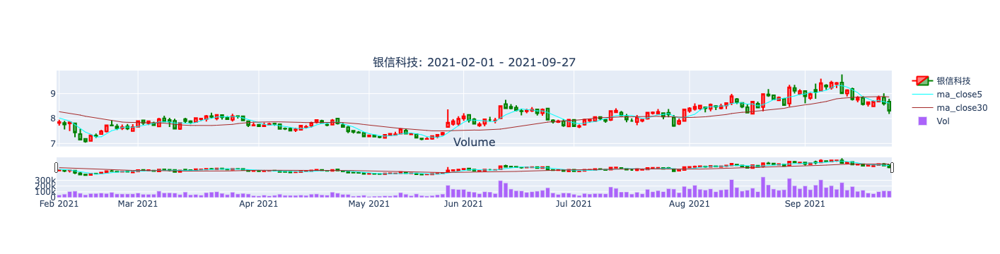

In [120]:
plot_k_plotly(df2.loc['300231.SZ']['2021-02-01':'2021-09-27'], ma_spans=[5,30])

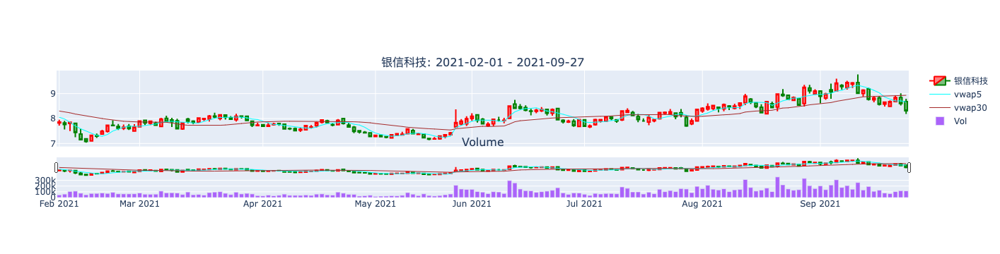

In [121]:
plot_k_plotly(df2.loc['300231.SZ']['2021-02-01':'2021-09-27'], ma_spans=[5,30], ma_col='vwap')

In [68]:
import bokeh.plotting as bplt
from bokeh.plotting import figure
from bokeh.io import show, output_notebook, output_file
from bokeh.palettes import Category20_20, Category20_16, inferno, magma
from bokeh.layouts import column, row, WidgetBox
from bokeh.models import Legend, Panel, ColumnDataSource, HoverTool, DatetimeTickFormatter
from bokeh.models.widgets import Tabs, CheckboxGroup, Slider, RangeSlider


def plot_mline(df, legend_labels, title, y_label, datespan=None, colors=None, w=800, h=450, verbose=False):
    summary = '''
        绘制单一 ts_code 的多指标线, 指标来自多个 column
    '''
    if verbose:
        print(summary)
    p = figure(plot_width=w, plot_height=h, title=title,
               x_axis_label= '交易日期', y_axis_label=y_label)
    p.xaxis[0].formatter = DatetimeTickFormatter()

    colors = Category20_16 if colors is None else colors
    legend_it=[]

    for legend, color in zip(legend_labels, colors):
        if datespan is not None:
            df=df[datespan].copy()
        c = p.line(df.index, df.loc[:,legend], line_width=2, color=color)
        legend_it.append((legend, [c]))

    legend = Legend(items=legend_it, location=(0, -60), click_policy='mute')
    p.add_layout(legend, 'right')
    show(p)


plot_mline(df3, legend_labels=['ma_close_5','vwap_5'], title='ma_v_vwap', y_label='Value')

In [15]:
import plotly.express as px

print("\n".join(wrap("".join('{:<12}'.format(c) for c in named_colorscales), 96)))

aggrnyl     agsunset    blackbody   bluered     blues       blugrn      bluyl       brwnyl
bugn        bupu        burg        burgyl      cividis     darkmint    electric    emrld
gnbu        greens      greys       hot         inferno     jet         magenta     magma
mint        orrd        oranges     oryel       peach       pinkyl      plasma      plotly3
pubu        pubugn      purd        purp        purples     purpor      rainbow     rdbu
rdpu        redor       reds        sunset      sunsetdark  teal        tealgrn     turbo
viridis     ylgn        ylgnbu      ylorbr      ylorrd      algae       amp         deep
dense       gray        haline      ice         matter      solar       speed       tempo
thermal     turbid      armyrose    brbg        earth       fall        geyser      prgn
piyg        picnic      portland    puor        rdgy        rdylbu      rdylgn      spectral
tealrose    temps       tropic      balance     curl        delta       oxy         edge
hsv     

In [135]:
test_stra_1 = {
    'name': 'Vibe',
    'filter': StockFilter(end_date).not_new().not_st(),
    'conditions':{
        'pre10_upstops': [
            {'op': '>', 'val': 1},
            {'op': '<', 'val': 4},
        ],
        'pre_ma_close_5': [
            {'op': '<', 'var': 'ma_close_5'}
        ],
        'pre2_ma_close_5': [
            {'op': '<', 'var': 'pre_ma_close_5'}
        ],
        'next_open_pct': [
            {'op': '<', 'val': 3},
            {'op': '>', 'val': -3}
        ],
        'close': {'op': '>', 'var': 'ma_close_5'},
        'pct_chg': [
            {'op': '>', 'val': 0},
            {'op': '<', 'val': 5}
        ]
    },
}

zhaban_stra = {
    'name': 'zhaban_v2',
    'filter': StockFilter(end_date).not_new().not_st(),
    
}

# 二：我自始至终觉得成交量这个指标非常重要，学会这点你将碾压80%的交易选手。
# 量比小于0.5，属于明显缩量，缩量能创新高，说明主力高度控盘，而且可以排除主力出货的可能，如果正好处于上升通道，则吃肉的概率极大。
# 如果股票涨停，量比小于1，说明还有较大的上涨空间，次日再次涨停的概率极大，
# 如果量比大于1.5，而且突破某个重要阻力位（比如20日均线）之后缩量回调的个股，是不可多得的买入对象。

# 四：早上大跌别急割，下午一般有反包，尾盘大涨要减仓，次日回调机率大。缩量上涨，还会上涨，缩量下跌，还会下跌，放量滞涨，头部已现，缩量止跌，底部已现，巨量急涨，必然回调，字字珠玑，成功率高达85%。

# 六：买入分歧，卖出一致，分歧产生溢价。这句话非常经典，我的体会就是当一个强势的股票出现分歧的时候，就是买点。分歧的表现就是连板的股票炸板，放量等特征，说明股票的多空双方的分歧比较大，出现分歧之后，后续继续上涨，当所有投资者都觉得还能继续上涨的时候，就是卖点。这里我总结一下做首阴反包要有几个要点：
# 1、要连板股，人气足，市场关注度高
# 2、首阴要杀得凶，市场分歧要足够大，对它能反包的市场预期不能太高
# 3、巨阴杀跌过程要满足两个条件：a.换手足 b.筹码换手要集中在杀跌当天的相对低位，否则会导致次日反包到高位时套牢盘的一致性卖压
# 4、巨阴杀跌次日出现意味着预期反转的超预期平开或者高开
# 5、首阴之日开始，调整不能超3个交易日，否则人气会逐渐涣散
# 如果以上五个条件都能满足到，那么该股的反包成功率会高很多。

In [145]:
x=pdl.parse(end_date)

In [159]:
end_date

'2021-09-17'

In [160]:
# tmpdf = StockFilter(end_date).not_st().filter(df).xs(slice('2021-06-20', '2021-09-17'), level=1, drop_level=False)
tmpdf = StockFilter(end_date).not_st().filter(df).xs(slice('2021-06-20', '2021-09-17'), level=1, drop_level=False)
tmp, keys = filter_by_strategy(tmpdf, test_stra_1['conditions'])
print(len(tmp))
tmp.drop(columns='name').join(dc.get_stock_basics()[['name']])[['name', 'pre10_upstops','ma_close_5', 'close', 'pct_chg', 'next_open_pct', 'next_pct_chg', 'next2_pct_chg']]

{'pre10_upstops': [{'op': '>', 'val': 1}, {'op': '<', 'val': 4}], 'pre_ma_close_5': [{'op': '<', 'var': 'ma_close_5'}], 'pre2_ma_close_5': [{'op': '<', 'var': 'pre_ma_close_5'}], 'next_open_pct': [{'op': '<', 'val': 3}, {'op': '>', 'val': -3}], 'close': {'op': '>', 'var': 'ma_close_5'}, 'pct_chg': [{'op': '>', 'val': 0}, {'op': '<', 'val': 5}]}
854


name  pre10_upstops  ma_close_5   close  pct_chg  \
ts_code   trade_date                                                     
000004.SZ 2021-07-16  国华网安            3.0      22.470   23.31   1.2598   
          2021-07-20  国华网安            3.0      24.148   25.97   1.2871   
000009.SZ 2021-06-21  中国宝安            2.0      15.298   16.24   1.4981   
          2021-08-10  中国宝安            2.0      25.138   25.59   0.2347   
000012.SZ 2021-07-15   南玻A            2.0      11.180   11.95   3.8228   
...                    ...            ...         ...     ...      ...   
688558.SH 2021-08-30  国盛智科            2.0      56.784   63.15   4.0020   
688595.SH 2021-07-26  芯海科技            2.0     127.542  134.62   1.9385   
688682.SH 2021-07-06   霍莱沃            2.0     143.088  165.87   1.6360   
          2021-07-07   霍莱沃            2.0     151.296  168.60   1.6459   
          2021-07-08   霍莱沃            2.0     162.522  173.78   3.0724   

                      next_open_pct  next_pct_chg  next2_pct_chg  
ts_code   trade_date                                              
000004.SZ 2021-07-16      -1.287001      9.995710      11.411411  
          2021-07-20       2.040816     -0.962649      -5.852907  
000009.SZ 2021-06-21       0.000000     -2.216749      -2.832512  
          2021-08-10      -2.227433     -1.641266      -4.337632  
000012.SZ 2021-07-15      -0.083682     -2.008368      -1.255230  
...                             ...           ...            ...  
688558.SH 2021-08-30      -0.633413     -0.712589      -5.922407  
688595.SH 2021-07-26       1.567375     -4.174714     -12.345862  
688682.SH 2021-07-06       0.078375      1.645867       4.768795  
          2021-07-07      -2.135231      3.072361      -9.845789  
          2021-07-08      -2.186673    -12.533088      -0.339510  

[854 rows x 8 columns]

In [149]:
tmp.xs('2021-09-13', level=1, drop_level=False)[['name', 'pre10_upstops','ma_close_5', 'close', 'pct_chg', 'next_open_pct', 'next_pct_chg', 'next2_pct_chg']]

KeyError: '2021-09-13'

In [114]:
tmp.next2_pct_chg.mean()

-0.3331060952892647

In [82]:
df.loc['603050.SH'][['name', 'pre10_upstops','ma_close_5', 'pre_ma_close_5', 'close', 'pct_chg']]

,name,pre10_upstops,ma_close_5,pre_ma_close_5,close,pct_chg
trade_date,,,,,,
2020-09-03,科林电气,NaN,NaN,NaN,13.64,-2.5299
2020-09-04,科林电气,NaN,NaN,NaN,13.76,0.8652
2020-09-07,科林电气,NaN,NaN,NaN,13.71,-0.3574
2020-09-08,科林电气,NaN,NaN,NaN,13.92,1.5065
2020-09-09,科林电气,NaN,13.778,NaN,13.86,-0.4240
...,...,...,...,...,...,...
2021-09-13,科林电气,NaN,17.260,16.892,17.67,-4.3831
2021-09-14,科林电气,NaN,17.526,17.260,17.21,-2.6033
2021-09-15,科林电气,NaN,17.614,17.526,17.91,4.0674


In [53]:
# missing: 鞍重股份(1 downstop), 银星能源
df.loc['603050.SH'][['name', 'pre10_upstops','ma_close_5', 'pre_ma_close_5', 'close', 'pct_chg']].tail(3)

,name,pre10_upstops,ma_close_5,pre_ma_close_5,close,pct_chg
trade_date,,,,,,
2021-09-15,NaN,2.0,17.614,17.526,17.91,4.0674
2021-09-16,NaN,2.0,17.734,17.614,17.40,-2.8476
2021-09-17,NaN,2.0,17.678,17.734,18.20,4.5977


In [116]:
df_init.loc[:, 'open_pct'] = (df_init.open - df_init.pre_close)/df_init.pre_close * 100
df_init.loc[:, 'next_open_pct'] = df_init.groupby(level='ts_code').open_pct.shift(-1)

In [132]:
df.loc[:, 'pre10_upstops'] 

ts_code    trade_date
000001.SZ  2020-09-03   NaN
           2020-09-04   NaN
           2020-09-07   NaN
           2020-09-08   NaN
           2020-09-09   NaN
                         ..
689009.SH  2021-09-13   NaN
           2021-09-14   NaN
           2021-09-15   NaN
           2021-09-16   NaN
           2021-09-17   NaN
Name: pre10_upstops, Length: 1074066, dtype: float64

In [133]:
df.upstop_num.fillna(0, inplace=True)
df.loc[:, 'pre10_upstops'] = df.groupby(level='ts_code').upstop_num.apply(lambda x: x.rolling(window=10, min_periods=1).sum())
df.loc['603507.SH'][['pre10_upstops','limit','pct_chg','upstop_num']].tail(20)

,pre10_upstops,limit,pct_chg,upstop_num
trade_date,,,,
2021-08-23,0.0,NaN,4.7775,0.0
2021-08-24,0.0,NaN,0.7658,0.0
2021-08-25,0.0,NaN,-0.9326,0.0
2021-08-26,0.0,NaN,0.6276,0.0
2021-08-27,0.0,NaN,-0.5544,0.0
2021-08-30,0.0,NaN,0.6620,0.0
2021-08-31,0.0,NaN,6.0921,0.0
2021-09-01,0.0,NaN,-4.0131,0.0
2021-09-02,1.0,U,9.9932,1.0


* 

In [13]:
df = gen_ma(df)
df.columns

Index(['open', 'high', 'low', 'close', 'pre_close', 'change', 'pct_chg', 'vol',
       'amount', 'adj_factor', 'turnover_rate', 'turnover_rate_f',
       'volume_ratio', 'pe', 'pe_ttm', 'total_mv', 'circ_mv', 'total_share',
       'float_share', 'free_share', 'last_factor', 'pre_close_4',
       'pre_close_6', 'pre_close_11', 'pre_close_21', 'pre_pct_chg',
       'pre3_pct_chg', 'pre5_pct_chg', 'pre10_pct_chg', 'pre20_pct_chg',
       'next_close_1', 'next_close_2', 'next_close_3', 'next_close_10',
       'next_close_20', 'next_pct_chg', 'next2_pct_chg', 'next3_pct_chg',
       'next10_pct_chg', 'next20_pct_chg', 'max_pre60_close',
       'max_pre120_close', 'open_preclose_pct', 'ma_vol_5', 'ma_vol_20',
       'vol_ratio', 'vol_ratio_long', 'vol_type', 'pre_vol_type', 'buy_sm_vol',
       'buy_md_vol', 'buy_lg_vol', 'buy_elg_vol', 'sell_sm_vol', 'sell_md_vol',
       'sell_lg_vol', 'sell_elg_vol', 'buy_sm_amount', 'buy_md_amount',
       'buy_lg_amount', 'buy_elg_amount', 'sell_sm_amou

In [15]:
df = gen_ma(df)
df.loc[:,'pre_ma_close_5'] = df.groupby(level='ts_code').ma_close_5.shift(1)
df.loc[:,'pre2_ma_close_5'] = df.groupby(level='ts_code').ma_close_5.shift(2)

In [12]:
df = gen_ma(df)
df

Index(['open', 'high', 'low', 'close', 'pre_close', 'change', 'pct_chg', 'vol',
       'amount', 'adj_factor', 'turnover_rate', 'turnover_rate_f',
       'volume_ratio', 'pe', 'pe_ttm', 'total_mv', 'circ_mv', 'total_share',
       'float_share', 'free_share', 'last_factor', 'pre_close_4',
       'pre_close_6', 'pre_close_11', 'pre_close_21', 'pre_pct_chg',
       'pre3_pct_chg', 'pre5_pct_chg', 'pre10_pct_chg', 'pre20_pct_chg',
       'next_close_1', 'next_close_2', 'next_close_3', 'next_close_10',
       'next_close_20', 'next_pct_chg', 'next2_pct_chg', 'next3_pct_chg',
       'next10_pct_chg', 'next20_pct_chg', 'max_pre60_close',
       'max_pre120_close', 'open_preclose_pct', 'ma_vol_5', 'ma_vol_20',
       'vol_ratio', 'vol_ratio_long', 'vol_type', 'pre_vol_type', 'buy_sm_vol',
       'buy_md_vol', 'buy_lg_vol', 'buy_elg_vol', 'sell_sm_vol', 'sell_md_vol',
       'sell_lg_vol', 'sell_elg_vol', 'buy_sm_amount', 'buy_md_amount',
       'buy_lg_amount', 'buy_elg_amount', 'sell_sm_amou

In [66]:
df_end[df_end.upstop_num==1]

,,open,high,low,close,pre_close,change,pct_chg,vol,amount,adj_factor,turnover_rate,turnover_rate_f,volume_ratio,pe,pe_ttm,total_mv,circ_mv,total_share,float_share,free_share,last_factor,buy_sm_vol,buy_md_vol,buy_lg_vol,buy_elg_vol,sell_sm_vol,sell_md_vol,sell_lg_vol,sell_elg_vol,buy_sm_amount,buy_md_amount,buy_lg_amount,buy_elg_amount,sell_sm_amount,sell_md_amount,sell_lg_amount,sell_elg_amount,net_mf_vol,net_mf_amount,name,amp,fc_ratio,fl_ratio,fd_amount,first_time,last_time,open_times,strth,limit,upstop_num,conseq_up_num,pre_open_times,pre_conseq_up_num,pre3_upstops,pre5_upstops,pre10_upstops,pre20_upstops,post_up_num
ts_code,trade_date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
000155.SZ,2021-09-17,34.10,37.33,32.68,37.33,33.94,3.39,9.9882,1230635.60,4.350745e+06,1.568,9.6900,17.1314,1.20,309.2743,250.5747,4740910.00,4740910.00,1.270000e+05,1.270000e+05,7.183519e+04,1.568,192898.0,265539.0,290532.0,481667.0,278573.0,349035.0,313605.0,289424.0,67086.45,92829.29,101918.37,173240.39,99052.31,123778.91,110752.41,101490.86,123823.0,43808.57,川能动力,13.70,7.2269,0.6632,314423800.0,14:13:33,14:13:33,0.0,52.055850,U,1.0,33.0,16.0,49.0,3.0,3.0,6.0,10.0,NaN
000516.SZ,2021-09-17,10.46,11.03,10.35,11.03,10.03,1.00,9.9701,1025573.06,1.099794e+06,39.872,5.4158,7.4743,2.55,553.4219,850.1478,2510347.80,2088701.60,2.275927e+05,1.893655e+05,1.372140e+05,39.872,176118.0,257549.0,251609.0,340298.0,313430.0,343440.0,210540.0,158163.0,18721.17,27413.20,26943.27,36901.75,33605.64,36732.74,22559.87,17081.14,123598.0,13231.73,国际医学,6.78,9.5689,0.5038,105237720.0,11:00:57,11:00:57,0.0,59.202076,U,1.0,16.0,26.0,0.0,-3.0,-1.0,-1.0,-1.0,NaN
000525.SZ,2021-09-17,5.70,5.96,5.65,5.96,5.68,0.28,4.9296,221206.66,1.307334e+05,7.524,3.8503,6.2514,1.00,NaN,NaN,346140.62,342410.84,5.807729e+04,5.745148e+04,3.538500e+04,7.524,34130.0,67594.0,75073.0,44409.0,55367.0,80571.0,59295.0,25973.0,2012.37,3986.36,4432.72,2641.87,3274.24,4756.88,3508.98,1533.24,-32551.0,-1962.80,ST红太阳,5.46,8.1510,0.3112,10656063.0,09:40:15,13:26:21,8.0,55.370660,U,1.0,24.0,39.0,17.0,3.0,5.0,8.0,14.0,NaN
000537.SZ,2021-09-17,12.00,12.50,12.00,12.50,11.36,1.14,10.0352,1147982.50,1.415376e+06,6.512,6.6303,25.8199,14.21,10.5270,13.0547,2328151.00,2164258.80,1.862521e+05,1.731407e+05,4.446111e+04,6.512,36429.0,55356.0,93128.0,963069.0,66894.0,176297.0,264481.0,640311.0,4474.34,6801.09,11442.74,118819.48,8290.57,21814.33,32724.71,78708.05,-555075.0,-68803.25,广宇发展,4.40,6.7661,0.4425,95765670.0,14:13:57,14:13:57,0.0,66.298740,U,1.0,8.0,0.0,6.0,3.0,5.0,8.0,8.0,NaN
000564.SZ,2021-09-17,3.21,3.21,3.21,3.21,3.06,0.15,4.9020,57722.77,1.852901e+04,3.020,0.2878,0.3180,0.17,NaN,NaN,1920223.20,643910.75,5.982004e+05,2.005952e+05,1.814980e+05,3.020,215.0,706.0,15487.0,41315.0,21866.0,15485.0,11876.0,8496.0,6.90,22.66,497.13,1326.20,701.91,497.07,381.20,272.72,-57723.0,-1852.90,*ST大集,0.00,212.5500,0.6116,39383404.0,09:25:00,09:25:00,0.0,72.439250,U,1.0,6.0,0.0,0.0,1.0,3.0,4.0,6.0,NaN
000587.SZ,2021-09-17,1.52,1.59,1.52,1.59,1.51,0.08,5.2980,303498.16,4.808561e+04,12.655,2.5020,3.4516,1.70,74.8979,3.3509,337676.16,192868.89,2.123749e+05,1.213012e+05,8.792881e+04,12.655,49760.0,106000.0,147738.0,0.0,82454.0,116101.0,104943.0,0.0,786.70,1677.88,2343.98,0.00,1305.71,1837.29,1665.56,0.00,-95792.0,-1532.99,*ST金洲,4.64,12.3135,0.3070,5921001.0,09:34:21,10:23:51,3.0,56.606697,U,1.0,22.0,4.0,107.0,1.0,1.0,6.0,12.0,NaN
000731.SZ,2021-09-17,12.56,12.56,12.56,12.56,11.42,1.14,9.9825,194556.60,2.443631e+05,11.309,3.2893,3.7456,0.17,71.6344,27.3624,742904.40,742904.40,5.914843e+04,5.914843e+04,5.194308e+04,11.309,9085.0,17624.0,17722.0,150126.0,28557.0,42768.0,70712.0,52520.0,1141.08,2213.57,2225.88,18855.78,3586.72,5371.62,8881.43,6596.54,-191562.0,-24060.16,四川美丰,0.00,61.9703,2.0384,151432660.0,09:25:00,09:25:00,0.0,67.168960,U,1.0,7.0,1.0,81.0,1.0,1.0,1.0,1.0,NaN
000791.SZ,2021-09-17,5.80,6.41,5.77,6.41,5.83,0.58,9.9485,1292199.20,8.114711e+05,3.831,9.5046,25.3761,1.60,19.7125,22.0261,871488.60,871471.80,1.35